In [1]:
import os
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '2'
import cv2
import csv
import time
import tensorflow as tf
import keras
import glob
from PIL import Image
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras.layers import Conv2D, Conv2DTranspose, Input, Activation,Concatenate
from tensorflow.keras.layers import BatchNormalization, LeakyReLU, Flatten, Dense, Dropout, UpSampling2D
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from matplotlib.figure import Figure
from mpl_toolkits.axes_grid1 import ImageGrid
from pprint import pprint
%matplotlib inline
from tensorflow.keras.preprocessing.image import load_img, img_to_array, array_to_img
from tensorflow.keras.callbacks import EarlyStopping
import logging
logging.getLogger('tensorflow').disabled = True
import warnings
warnings.filterwarnings('ignore', category=UserWarning)

# Image Augmentation Functions

In [2]:
from scipy.ndimage import binary_erosion
import random
import math

def flip_horizontal(img):
    background = tf.constant([-1.0, -1.0, -1.0])
    mask = tf.math.greater(img, background)
    # print("mask.shape", tf.shape(mask), mask.shape)
    tmp = tf.math.logical_or(mask[:,:,0], mask[:,:,1])
    mask = tf.math.logical_or(mask[:,:,2], tmp)
    # print("mask.shape", tf.shape(mask), mask.shape)
    #print("mask.dtype", mask.dtype)
    #mask = tf.cast(mask, tf.bool)
    mshape = tf.shape(mask)
    mask = tf.reshape(mask, [mshape[0], mshape[1], 1]) #mshape[2], 1])
    mshape = tf.shape(mask)
    flipped = tf.image.flip_left_right(img)
    mask = tf.image.flip_left_right(mask)
    mask = tf.where(mask, tf.ones(mshape), tf.zeros(mshape))
    kernel = tf.zeros([3, 3, mshape[2]])#mshape[3]]) 
    mask = tf.reshape(mask, [1, mshape[0], mshape[1], 1])
    mask = tf.nn.erosion2d(mask, kernel, (1,1,1,1), "SAME", "NHWC", (1,1,1,1))
        
    mask = tf.math.greater(mask, 0.0)
    mask = tf.reshape(mask, [mshape[0], mshape[1], 1])
    
    # Assuming blue is out of screen, green is to the (viewer's) right, and red is down?
    # So left-right flip means negating the green channel
    mat = [[1.0,0.0,0.0],[0.0,-1.0,0.0],[0.0,0.0,1.0]]
    mult = tf.linalg.matvec(mat, flipped)
    fshape = tf.shape(flipped)
    # print("flipped.shape", flipped.shape)
    flipped = tf.where(mask, mult, tf.ones(fshape)*-1.0)
    return flipped


def myrotate(img):
    return tf.keras.preprocessing.image.apply_affine_transform(img, theta=angle, zx=zoom, zy=zoom)


def random_rotate(img):
    #res = []
    res = tf.TensorArray(tf.float32, size=0, dynamic_size=True)
    ishape = tf.shape(img)
    for i in range(ishape[0]):
        global angle, zoom
        angle = (random.random()-0.5)*40 # plus or minus 20 degree in degrees (0.1745 radians)
        zoom = 1.0 + (random.random()-0.5)*0.2
        # print("angle", angle)
        background = tf.constant([-1.0, -1.0, -1.0])
        mask = tf.math.greater(img[i, :,:,:], background)
        tmp = tf.math.logical_or(mask[:,:,0], mask[:,:,1])
        mask = tf.math.logical_or(mask[:,:,2], tmp)
        mshape = tf.shape(mask)
        mask = tf.reshape(mask, [mshape[0], mshape[1], -1])
        img_i = img[i, :,:,:]
        # print("img_i.shape", tf.shape(img_i))
        img_i = tf.transpose(img_i, [2, 0, 1])
        #flipped = tf.keras.preprocessing.image.apply_affine_transform(img_i, theta=angle, zx=zoom, zy=zoom) #, row_axis=0, col_axis=1, channel_axis=2)
        #flipped = tf.py_function(func=tf.keras.preprocessing.image.apply_affine_transform, inp=(img_i, theta=angle, zx=zoom, zy=zoom), Tout=tf.float32) #, row_axis=0, col_axis=1, channel_axis=2)
        flipped = tf.py_function(func=myrotate, inp=[img_i], Tout=tf.float32) #, row_axis=0, col_axis=1, channel_axis=2)
        flipped = tf.transpose(flipped, [1, 2, 0])
        mask = tf.transpose(mask, [2,0,1])
        mshape = tf.shape(mask)
        mask = tf.where(mask, tf.ones(mshape), tf.zeros(mshape))
        #mask = tf.keras.preprocessing.image.apply_affine_transform(mask, theta=angle, zx=zoom, zy=zoom)
        mask = tf.py_function(func=myrotate, inp=[mask], Tout=tf.float32)
        mask = tf.math.greater(mask, 0.0)
        mask = tf.transpose(mask, [1,2,0])
        #mask = tf.where(mask, tf.ones(mask.shape), tf.zeros(mask.shape))
        #kernel = tf.zeros([3, 3, mask.shape[2]]) 
        #mask = tf.reshape(mask, [1, mask.shape[0], mask.shape[1], mask.shape[2]])
        #mask = tf.nn.erosion2d(mask, kernel, (1,1,1,1), "SAME", "NHWC", (1,1,1,1))
        
        #mask = tf.math.greater(mask, 0.0)
        #mask = tf.reshape(mask, [mask.shape[1], mask.shape[2], mask.shape[3]])
        
        # Assuming blue is out of screen, green is to the (viewer's) right, and red is down?
        # So left-right flip means negating the green channel
        angle = math.pi*angle/180.0
        mat = [[1.0,0.0,0.0],[0.0,math.cos(angle),math.sin(angle)],[0.0,-math.sin(angle),math.cos(angle)]]
        #print("flipped.shape", flipped.shape)
        mult = tf.linalg.matvec(mat, flipped)
        fshape = tf.shape(flipped)
    
        flipped = tf.where(mask, mult, tf.ones(fshape)*-1.0)
        #res.append(flipped)
        res = res.write(res.size(), flipped)
    flipped = res.stack()#tf.stack(res)
    # print("flipped.shape", tf.shape(flipped))
    return flipped

def random_rotate_single(img):
    global angle, zoom
    angle = (random.random()-0.5)*40 # plus or minus 20 degree in degrees (0.1745 radians)
    zoom = 1.0 + (random.random()-0.5)*0.2
    # # print("angle", angle)
    background = tf.constant([-1.0, -1.0, -1.0])
    mask = tf.math.greater(img, background)
    tmp = tf.math.logical_or(mask[:,:,0], mask[:,:,1])
    mask = tf.math.logical_or(mask[:,:,2], tmp)
    mshape = tf.shape(mask)
    mask = tf.reshape(mask, [mshape[0], mshape[1], -1])
    # print("img.shape", tf.shape(img))
    img = tf.transpose(img, [2, 0, 1])
    #flipped = tf.keras.preprocessing.image.apply_affine_transform(img_i, theta=angle, zx=zoom, zy=zoom) #, row_axis=0, col_axis=1, channel_axis=2)
    #flipped = tf.py_function(func=tf.keras.preprocessing.image.apply_affine_transform, inp=(img_i, theta=angle, zx=zoom, zy=zoom), Tout=tf.float32) #, row_axis=0, col_axis=1, channel_axis=2)
    flipped = tf.py_function(func=myrotate, inp=[img], Tout=tf.float32) #, row_axis=0, col_axis=1, channel_axis=2)
    flipped = tf.transpose(flipped, [1, 2, 0])
    mask = tf.transpose(mask, [2,0,1])
    mshape = tf.shape(mask)
    mask = tf.where(mask, tf.ones(mshape), tf.zeros(mshape))
    #mask = tf.keras.preprocessing.image.apply_affine_transform(mask, theta=angle, zx=zoom, zy=zoom)
    mask = tf.py_function(func=myrotate, inp=[mask], Tout=tf.float32)
    mask = tf.math.greater(mask, 0.0)
    mask = tf.transpose(mask, [1,2,0])
    #mask = tf.where(mask, tf.ones(mask.shape), tf.zeros(mask.shape))
    #kernel = tf.zeros([3, 3, mask.shape[2]]) 
    #mask = tf.reshape(mask, [1, mask.shape[0], mask.shape[1], mask.shape[2]])
    #mask = tf.nn.erosion2d(mask, kernel, (1,1,1,1), "SAME", "NHWC", (1,1,1,1))
        
    #mask = tf.math.greater(mask, 0.0)
    #mask = tf.reshape(mask, [mask.shape[1], mask.shape[2], mask.shape[3]])
        
    # Assuming blue is out of screen, green is to the (viewer's) right, and red is down?
    # So left-right flip means negating the green channel
    angle = math.pi*angle/180.0
    mat = [[1.0,0.0,0.0],[0.0,math.cos(angle),math.sin(angle)],[0.0,-math.sin(angle),math.cos(angle)]]
    #print("flipped.shape", flipped.shape)
    mult = tf.linalg.matvec(mat, flipped)
    fshape = tf.shape(flipped)
    
    flipped = tf.where(mask, mult, tf.ones(fshape)*-1.0)
        
    return flipped
#flipped_dataset = train_dataset.map(flip_horizontal)

def applyFlip(ds):
  return train_dataset.map(flip_horizontal)

def applyRotate(ds):
  return train_dataset.map(random_rotate_single)

def flipRotate(img):
  img = flip_horizontal(img)
  img = random_rotate_single(img)
  return img
  
def applyFlipRotate(ds):
  return train_dataset.map(flipRotate)
  
# for images in train_dataset.take(1):
#     flip = flip_horizontal(images)
#     print("images.shape", images.shape)
    
#     flip = random_rotate(flip)
#     print("flip.shape", flip.shape)
#     for ax, img in zip(ImageGrid(plt.figure(figsize=(12, 8)), 111, nrows_ncols=(2, 3), axes_pad=0.3), flip):
#         ax.imshow((img+1)/2)
#         ax.axis('off')
#     for ax, img in zip(ImageGrid(plt.figure(figsize=(12, 8)), 111, nrows_ncols=(2, 3), axes_pad=0.3), images):
#         ax.imshow((img+1)/2)
#         ax.axis('off')

# plt.suptitle('Examples Of Six Training Images from flipped dataset', fontsize='xx-large',fontweight='heavy')
# plt.show()

# Preparation and presentation of datasets

### Acquire and Preprocess Dataset

In [3]:
BATCH_SIZE = 15

img_dir = '../dataset/sfs-net/'

train_files = glob.glob(img_dir + 'train/0003/*normal*.png')
test_files = glob.glob(img_dir + 'test/0603/*normal*.png')

def preprocess(images):
    images = tf.image.resize(images, [256, 256])
    images = tf.cast(images, tf.float32)
    images = (images - 127.5) / 127.5 # [-1, 1]
    return images


def load_and_preprocess_image(file_path):
    # print("file_path", file_path)
    # Load the image from file
    image = tf.io.read_file(file_path)
    # Decode the image to a tensor
    image = tf.image.decode_jpeg(image, channels=3)
    # Preprocess the image
    image = preprocess(image)
    return image


def normalise(images):
    images,images_norm = tf.linalg.normalize(images, axis=2) #Normalise the input data
    return images


train_dataset = tf.data.Dataset.from_tensor_slices(train_files)
test_dataset = tf.data.Dataset.from_tensor_slices(test_files)

print("Original training dataset size:", len(train_files))
print("Original testing dataset size:", len(test_files))

train_dataset = train_dataset.map(load_and_preprocess_image)
test_dataset = test_dataset.map(load_and_preprocess_image)
img = train_dataset.take(1)
print("Original - img.element_spec", img.element_spec)
train_dataset_width = int(img.element_spec.shape[0])
train_dataset_height = int(img.element_spec.shape[1])

# augmentations
flipped_dataset = train_dataset.map(flip_horizontal)#apply(applyFlip)#
rotated_dataset = train_dataset.map(random_rotate_single)#apply(applyRotate)#
flipped_rotated = train_dataset.map(flipRotate)#apply(applyFlipRotate)#apply(applyFlip).apply(applyRotate)

train_dataset = train_dataset.concatenate(rotated_dataset)
train_dataset = train_dataset.concatenate(flipped_dataset)
train_dataset = train_dataset.concatenate(flipped_rotated)

#train_dataset.save(img_dir + 'train/augmented/')
#train_dataset = tf.data.Dataset.load(img_dir + 'train/augmented/')

train_dataset = train_dataset.map(normalise)
test_dataset = test_dataset.map(normalise)

print("Augmented training dataset size:", len(list(train_dataset)))
print("Augmented testing dataset size:", len(list(test_dataset)))

train_dataset = train_dataset.shuffle(len(train_files)*2).batch(BATCH_SIZE).prefetch(tf.data.experimental.AUTOTUNE)
test_dataset = test_dataset.batch(BATCH_SIZE).prefetch(tf.data.experimental.AUTOTUNE)

print("Total number of batches in training dataset:", len(list(train_dataset)))
print("Total number of batches in testing dataset:", len(list(test_dataset)))
print("train dataset: ", tf.data.DatasetSpec.from_value(train_dataset))
print("test dataset: ", tf.data.DatasetSpec.from_value(test_dataset))

train_dataset = train_dataset.prefetch(100).cache()

Original training dataset size: 300
Original testing dataset size: 105
Original - img.element_spec TensorSpec(shape=(256, 256, 3), dtype=tf.float32, name=None)
Augmented training dataset size: 1200
Augmented testing dataset size: 105
Total number of batches in training dataset: 80
Total number of batches in testing dataset: 7
train dataset:  DatasetSpec(TensorSpec(shape=(None, None, None, 3), dtype=tf.float32, name=None), TensorShape([]))
test dataset:  DatasetSpec(TensorSpec(shape=(None, 256, 256, 3), dtype=tf.float32, name=None), TensorShape([]))


### Show some images on the train dataset

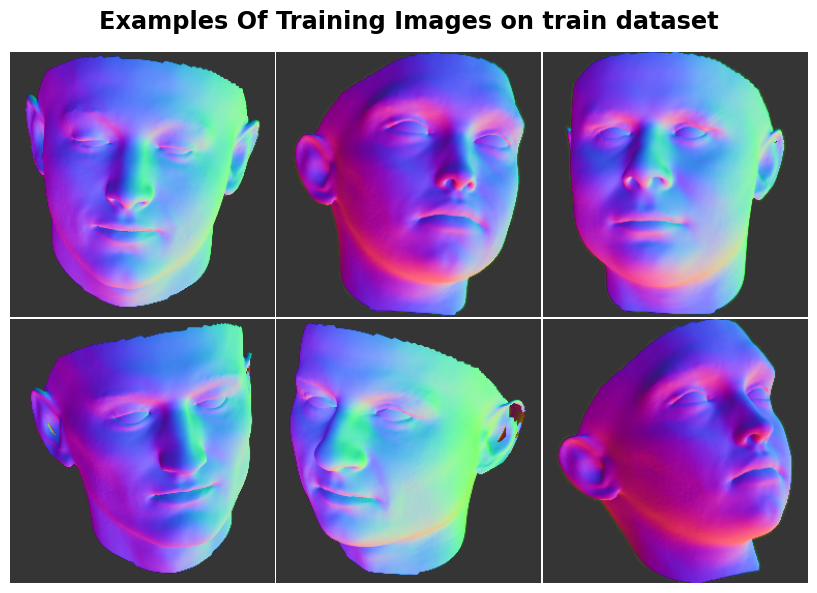

In [4]:
for images in train_dataset.take(1):
    for ax, img in zip(ImageGrid(plt.figure(figsize=(9, 6)), 111, nrows_ncols=(2, 3)), images):
        ax.imshow((img+1)/2)
        ax.axis('off')
plt.suptitle('Examples Of Training Images on train dataset', fontsize='xx-large',fontweight='heavy')
plt.tight_layout()
plt.show()

### Show some images on the test dataset

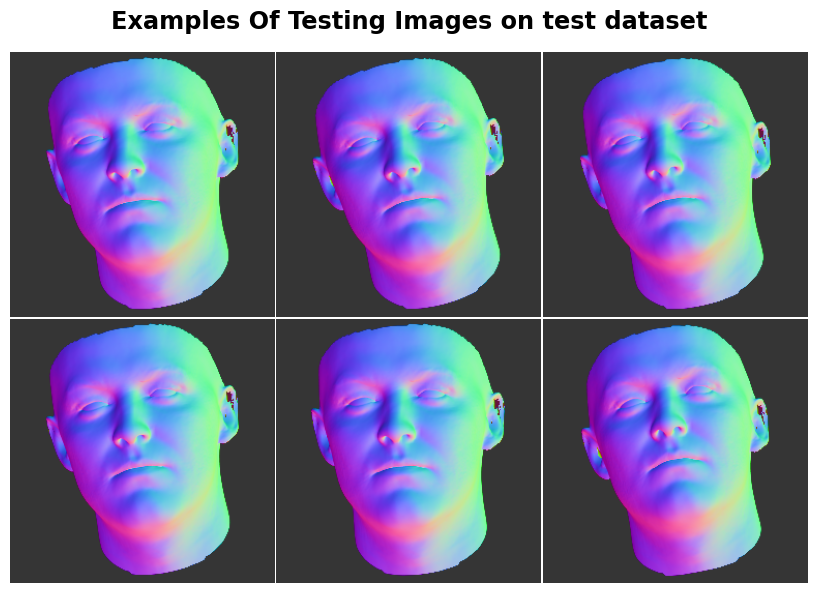

In [5]:
for images in test_dataset.take(1):
    for ax, img in zip(ImageGrid(plt.figure(figsize=(9, 6)), 111, nrows_ncols=(2, 3)), images):
        ax.imshow((img+1)/2)
        ax.axis('off')
plt.suptitle('Examples Of Testing Images on test dataset', fontsize='xx-large',fontweight='heavy')
plt.tight_layout()
plt.show()

# Mask Code Set

### Generate Irregular Mask (batch size)

In [6]:
def mask_irregular(batch_size, mask_width, mask_height):
    mask = np.zeros((batch_size, mask_width, mask_height, 1))

    for i in range(batch_size):
        # Randomly choose the center of the circle
        center_x = np.random.randint(mask_width // 6, mask_width - mask_width // 6)
        center_y = np.random.randint(mask_height // 6, mask_height - mask_height // 6)

        # Randomly determine the radius of the circle
        radius = np.random.randint(min(mask_width, mask_height) // 10, min(mask_width, mask_height) // 4)

        # Create a blob with the random center and radius
        cv2.circle(mask[i], (center_x, center_y), radius, (1,1,1), -1)

    return np.float32(((1 - mask)*2) - 1)  # Normalize to [-1, 1]

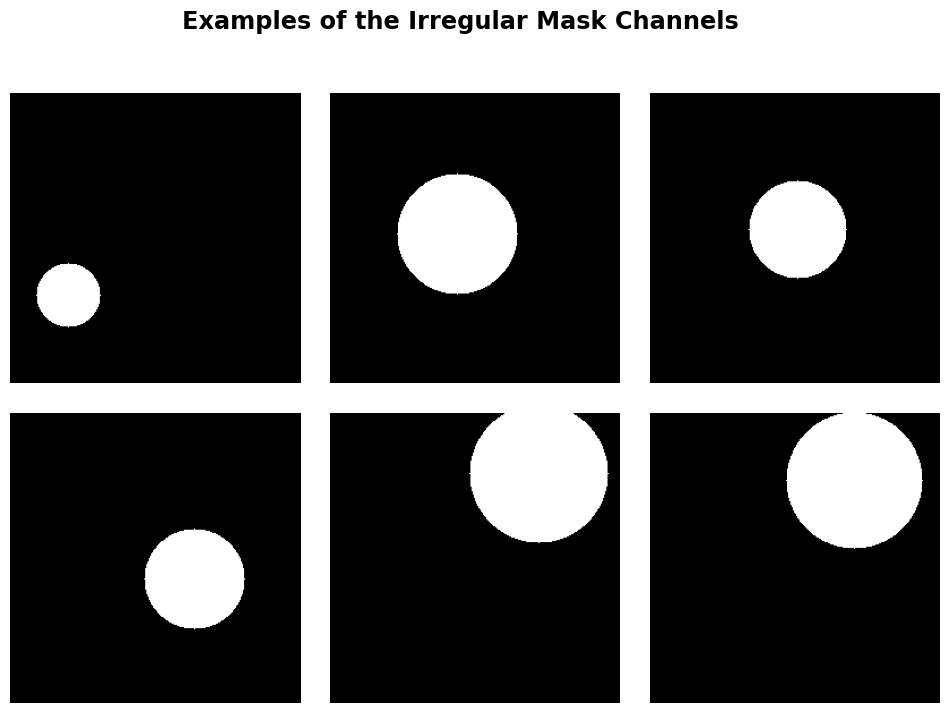

In [7]:
irregular_mask_examples = mask_irregular(6, train_dataset_width, train_dataset_height)
for ax, img in zip(ImageGrid(plt.figure(figsize=(12, 8)), 111, nrows_ncols=(2, 3), axes_pad=0.3), 
                   irregular_mask_examples):
    ax.imshow((img+1)/2, cmap='binary')
    ax.axis('off')
plt.suptitle('Examples of the Irregular Mask Channels', fontsize='xx-large',fontweight='heavy')
plt.show()

### Generate the masked imgs (batch size)

In [8]:
def masked_imgs(raw_imgs, mask_channels):
    
    raw_imgs = (raw_imgs + 1.0) / 2.0 # [0, 1]
    mask_channels = (mask_channels + 1.0) / 2.0 # [0, 1]
    
    # masked_images = np.multiply(raw_imgs, mask_channels)
    masked_images = tf.multiply(raw_imgs, mask_channels)  # 使用 tf.multiply 替代 np.multiply
    
    masked_images = (masked_images * 2.0) - 1.0 # [-1, 1]
    
#     masked_images[:][masked_images[:] == 0] = 1. # Set the white mask
    
    return masked_images

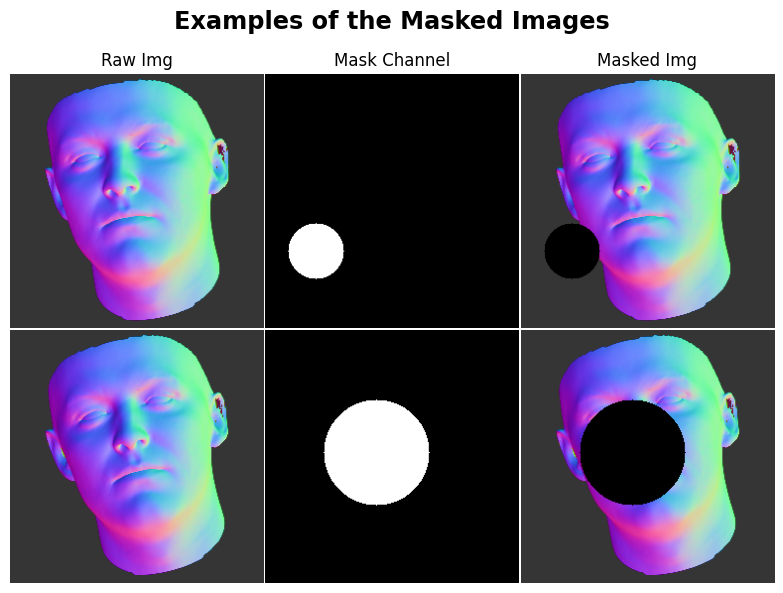

In [9]:
for images_batch in test_dataset.take(1):
    raw_images_examples = images_batch[:2]

irregular_mask_examples = irregular_mask_examples[:2]
masked_images_examples = masked_imgs(raw_images_examples, irregular_mask_examples)

grid = ImageGrid(plt.figure(figsize=(9, 6)), 111, nrows_ncols=(2, 3))

for i in range(2):
    ax = grid[i*3]
    ax.imshow((raw_images_examples[i]+1)/2)
    ax.axis('off')
    if i == 0:
        ax.set_title('Raw Img')
    
    ax = grid[i*3+1]
    ax.imshow((irregular_mask_examples[i]+1)/2, cmap='binary')
    ax.axis('off')
    if i == 0:
        ax.set_title('Mask Channel')
    
    ax = grid[i*3+2]
    ax.imshow((masked_images_examples[i]+1)/2)
    ax.axis('off')
    if i == 0:
        ax.set_title('Masked Img')
    
plt.suptitle('Examples of the Masked Images', fontsize='xx-large',fontweight='heavy')
plt.tight_layout()
plt.show()

### Generate the pred only masked region imgs (batch size)

In [10]:
def only_masked_region_pred_imgs(mask_channels, masked_imgs, pred_imgs):
    
    mask_channels = (mask_channels + 1.0) / 2.0 # [0, 1]
    masked_imgs = (masked_imgs + 1.0) / 2.0 # [0, 1]
    pred_imgs = (pred_imgs + 1.0) / 2.0 # [0, 1]
    
    masked_region_pred_imgs = masked_imgs + pred_imgs * (1.0 - mask_channels)
    
    masked_region_pred_imgs = (masked_region_pred_imgs * 2.0) - 1.0 # [-1, 1]
    
    return masked_region_pred_imgs

# Painting Function

In [11]:
def generator_plot_images(gen_model, text, dataset, num=3, save_path='./saved_images', epoch=0, save_images=False):
    os.makedirs(save_path, exist_ok=True)
    
    for images_batch in dataset.take(1):
        raw_images = images_batch
        mask_channels = mask_irregular(raw_images.shape[0], raw_images.shape[1], raw_images.shape[2])
        masked_images = masked_imgs(raw_images, mask_channels)
        pred_images = gen_model([masked_images, mask_channels], training=False)
        pred_images, pred_norm = tf.linalg.normalize(pred_images, axis=3)

        masked_region_pred_images = only_masked_region_pred_imgs(mask_channels, masked_images, pred_images)
    
    grid = ImageGrid(plt.figure(figsize=(12, num*3)), 111, nrows_ncols=(num, 4))
    
    for i in range(num):
        
        ax = grid[i*4]
        ax.imshow((raw_images[i]+1)/2)
        ax.axis('off')
        if i == 0:
            ax.set_title('Raw {} Img'.format(text))

        ax = grid[i*4+1]
        ax.imshow((masked_images[i]+1)/2)
        ax.axis('off')
        if i == 0:
            ax.set_title('Masked {} Img'.format(text))
            
        ax = grid[i*4+2]
        ax.imshow((pred_images[i]+1)/2)
        ax.axis('off')
        if i == 0:
            ax.set_title('Pred {} Img'.format(text))
        
        ax = grid[i*4+3]
        ax.imshow((masked_region_pred_images[i]+1)/2)
        ax.axis('off')
        if i == 0:
            ax.set_title('Pred Only Masked Reg. {} Img'.format(text))
        
    plt.tight_layout()
    if save_images:
        image_save_path = os.path.join(save_path, f'{text}_epoch_{epoch}.png')
        plt.savefig(image_save_path)   
    plt.show()

In [12]:
def plot_loss_metric(train_loss, train_metric, test_loss, test_metric, title, metric, start=0):
    x_values = range(start, start + len(train_loss))

    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 5))

    # Plotting the training set
    ax_train_loss = ax1
    ax_train_metric = ax1.twinx()
    ax_train_loss.plot(x_values, train_loss, color='tab:red')
    ax_train_metric.plot(x_values, train_metric, color='tab:blue')

    ax_train_loss.set_xlabel('Epochs')
    ax_train_loss.set_ylabel('Loss', color='tab:red')
    ax_train_metric.set_ylabel(metric, color='tab:blue')

    ax_train_loss.tick_params(axis='y', labelcolor='tab:red')
    ax_train_metric.tick_params(axis='y', labelcolor='tab:blue')

    ax1.set_title('Train - ' + title)

    # Plotting the test set
    ax_test_loss = ax2
    ax_test_metric = ax2.twinx()
    ax_test_loss.plot(x_values, test_loss, color='tab:green')
    ax_test_metric.plot(x_values, test_metric, color='tab:purple')

    ax_test_loss.set_xlabel('Epochs')
    ax_test_loss.set_ylabel('Loss', color='tab:green')
    ax_test_metric.set_ylabel(metric, color='tab:purple')

    ax_test_loss.tick_params(axis='y', labelcolor='tab:green')
    ax_test_metric.tick_params(axis='y', labelcolor='tab:purple')

    ax2.set_title('Test - ' + title)

    plt.tight_layout()
    plt.show()

# Model Definition Code Set

### Define the loss

In [13]:
cross_entropy = tf.keras.losses.BinaryCrossentropy()
# Cosine Similarity
cosine_loss = tf.keras.losses.CosineSimilarity(axis=3)

### Generator (encoder-decoder network)

In [14]:
class UnitNormalize(tf.keras.layers.Layer):
    def __init__(self):
        super(UnitNormalize, self).__init__()

    def call(self, inputs):
        return tf.math.l2_normalize(inputs, axis=2, epsilon=1e-6)

In [15]:
def generator_model():
    
    masked_image = tf.keras.layers.Input(shape=((256, 256, 3)))
    mask = tf.keras.layers.Input(shape=((256, 256, 1)))
    maskedImage_mask = tf.keras.layers.concatenate([masked_image, mask])
    
    # Encoder with skip connections
    skips = []
    
    # Encoder - Input a masked image and mask
    
    # (256, 256, 4) -> (128, 128, 64) 
    x = Conv2D(64, kernel_size=4, strides=2, padding="same")(maskedImage_mask)
    x = LeakyReLU(alpha=0.2)(x)
    skips.append(x)
    
    # (128, 128, 64) -> (64, 64, 128) 
    x = Conv2D(128, kernel_size=4, strides=2, padding="same")(x)
    x = LeakyReLU(alpha=0.2)(x)
    x = BatchNormalization()(x)
    skips.append(x)
    
    # (64, 64, 128) -> (32, 32, 256) 
    x = Conv2D(256, kernel_size=4, strides=2, padding="same")(x)
    x = LeakyReLU(alpha=0.2)(x)
    x = BatchNormalization()(x)
    skips.append(x)
    
    # (32, 32, 256) -> (16, 16, 512) 
    x = Conv2D(512, kernel_size=4, strides=2, padding="same")(x)
    x = LeakyReLU(alpha=0.2)(x)
    x = BatchNormalization()(x)
    skips.append(x)
    
    # (16, 16, 512) -> (8, 8, 512) 
    x = Conv2D(512, kernel_size=4, strides=2, padding="same")(x)
    x = LeakyReLU(alpha=0.2)(x)
    x = BatchNormalization()(x)
    skips.append(x)
    
    # (8, 8, 512) -> (4, 4, 512) 
    x = Conv2D(512, kernel_size=4, strides=2, padding="same")(x)
    x = LeakyReLU(alpha=0.2)(x)
    x = BatchNormalization()(x)
    skips.append(x)
    
    # (4, 4, 512) -> (2, 2, 512) 
    x = Conv2D(512, kernel_size=4, strides=2, padding="same")(x)
    x = LeakyReLU(alpha=0.2)(x)
    x = BatchNormalization()(x)
    skips.append(x)

    # (2, 2, 512) -> (1, 1, 512) 
    x = Conv2D(512, kernel_size=4, strides=2, padding="same")(x)
    x = LeakyReLU(alpha=0.2)(x)
    x = BatchNormalization()(x)
    skips.append(x)
    
    # Decoder
    # Decoder with skip connections
    # Assuming x is the output of the last layer of the encoder
    for skip_layer in reversed(skips[:-1]):  # Not using the last skip connection
        x = Conv2DTranspose(x.shape[-1] // 2, kernel_size=4, strides=2, padding="same")(x)
        x = LeakyReLU(alpha=0.2)(x)
        x = BatchNormalization()(x)
        x = Concatenate()([x, skip_layer])  # skip connection
    
    # Final layer
    # (128, 128, 16) -> (256, 256, 3)
    x = Conv2DTranspose(3, kernel_size=4,strides=2,padding="same")(x)
    
    x = Activation('tanh')(x) # [-1, 1]
    output = UnitNormalize()(x)
    
    model = tf.keras.Model(inputs=[masked_image, mask], outputs=output)

    return model

In [16]:
def generator_loss(fake_output, target_images, generated_images, 
                   lambda_reconstruction = 999, lambda_adversarial=1):
    
    reconstruction_loss = 1 + cosine_loss(target_images, generated_images)
    
    adversarial_loss = cross_entropy(tf.ones_like(fake_output), fake_output)
    
    total_loss = lambda_reconstruction * reconstruction_loss + lambda_adversarial * adversarial_loss
    
    return total_loss

In [17]:
def generator_ssim(target_images, generated_images):
    ssim = tf.image.ssim(target_images, generated_images, max_val=2.0)
    ssim = tf.reduce_mean(ssim)
    return ssim

In [18]:
def generator_psnr(target_images, generated_images):
    psnr = tf.image.psnr(target_images, generated_images, max_val=2.0)
    psnr = tf.reduce_mean(psnr)
    return psnr

In [19]:
generator = generator_model()
generator_optimizer = tf.keras.optimizers.legacy.Adam(1e-4)

### Discriminator

In [20]:
def discriminator_model():
    
    image = tf.keras.layers.Input(shape=(256, 256, 3), name="input_layer")
    
    # (256, 256, 3) -> (128, 128, 32)
    x = Conv2D(32, kernel_size=4, strides=2, padding="same", name="conv1")(image)
    x = LeakyReLU(alpha=0.2)(x)
    
    # (128, 128, 32) -> (64, 64, 64)
    x = Conv2D(64, kernel_size=4, strides=2, padding="same", name="conv2")(x)
    x = BatchNormalization()(x)
    x = LeakyReLU(alpha=0.2)(x)

    # (64, 64, 64) -> (32, 32, 128)
    x = Conv2D(128, kernel_size=4, strides=2, padding="same", name="conv3")(x)
    x = BatchNormalization()(x)
    x = LeakyReLU(alpha=0.2)(x)
    
    # (32, 32, 128) -> (16, 16, 256)
    x = Conv2D(256, kernel_size=4, strides=2, padding="same", name="conv4")(x)
    x = BatchNormalization()(x)
    x = LeakyReLU(alpha=0.2)(x)
    
    # (16, 16, 256) -> (8, 8, 512)
    x = Conv2D(512, kernel_size=4, strides=2, padding="same", name="conv5")(x)
    x = BatchNormalization()(x)
    x = LeakyReLU(alpha=0.2)(x)
    
    # (8, 8, 512) -> (4, 4, 1024)
    x = Conv2D(1024, kernel_size=4, strides=2, padding="same", name="conv6")(x)
    x = BatchNormalization()(x)
    x = LeakyReLU(alpha=0.2)(x)
    
    # (4, 4, 1024) -> (1, 1, 1)
    x = Conv2D(1, kernel_size=4, strides=1, padding="valid", name="conv7")(x)

    x = Flatten()(x)
    
    output = Dense(1, name="dense1")(x)
    output = Activation('sigmoid')(output)
    
    model = tf.keras.Model(inputs=image, outputs=output)
    
    return model

In [21]:
def discriminator_loss(real_output, fake_output):
    real_loss = cross_entropy(tf.ones_like(real_output), real_output)
    fake_loss = cross_entropy(tf.zeros_like(fake_output), fake_output)
    total_loss = real_loss + fake_loss
    return total_loss

In [22]:
def discirminator_acc(real_output, fake_output):
    real_acc = tf.reduce_mean(tf.cast(tf.greater(real_output, 0.5), tf.float32))
    fake_acc = tf.reduce_mean(tf.cast(tf.less(fake_output, 0.5), tf.float32))
    total_acc = (real_acc + fake_acc) / 2.0
    return total_acc

In [23]:
discriminator = discriminator_model()
discriminator_optimizer = tf.keras.optimizers.legacy.Adam(1e-4)

# Demonstration of an untrained model

### Use of (untrained) discriminator to classify the generated images as true or false

In [24]:
real_decision = discriminator(raw_images_examples)
pred_images_examples = generator([masked_images_examples, irregular_mask_examples], training=False)
fake_decision = discriminator(pred_images_examples)

print ("Real Images: ",real_decision)
print ("Fake Images: ",fake_decision)
print("Discirminator Loss: ", discriminator_loss(real_decision,fake_decision))
print("Discirminator Accuracy: ", discirminator_acc(real_decision,fake_decision))

Real Images:  tf.Tensor(
[[0.4995292 ]
 [0.49954736]], shape=(2, 1), dtype=float32)
Fake Images:  tf.Tensor(
[[0.50008607]
 [0.50001305]], shape=(2, 1), dtype=float32)
Discirminator Loss:  tf.Tensor(1.3873174, shape=(), dtype=float32)
Discirminator Accuracy:  tf.Tensor(0.0, shape=(), dtype=float32)


### Generate some images using (untrained) generator

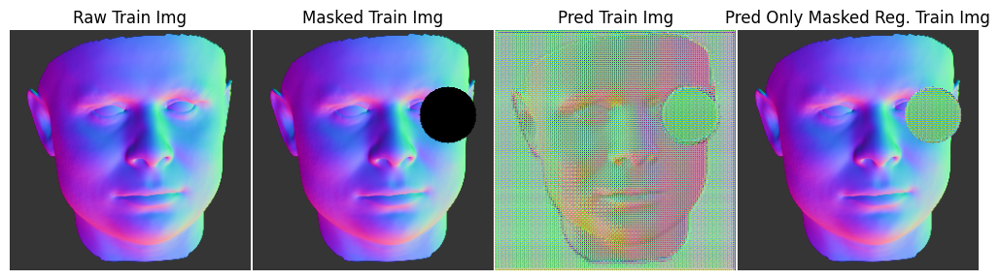

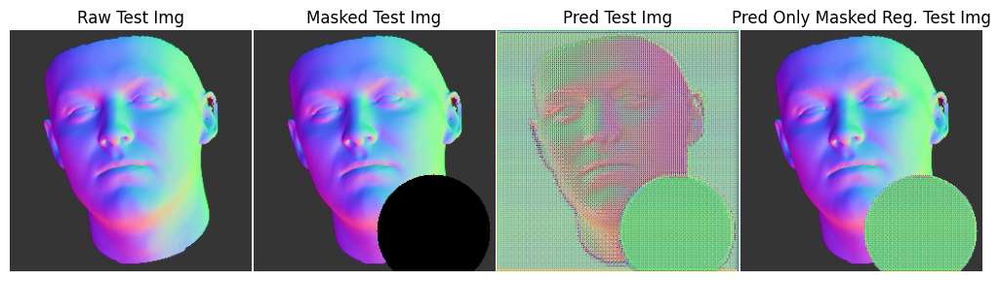

In [25]:
generator_plot_images(generator, 'Train', train_dataset, num = 1)
generator_plot_images(generator, 'Test', test_dataset, num = 1)

In [26]:
print("Generator Loss: ", generator_loss(fake_decision, raw_images_examples,pred_images_examples))
print("Generator SSIM: ", generator_ssim(raw_images_examples,pred_images_examples))
print("Generator PSNR: ", generator_psnr(raw_images_examples,pred_images_examples))

Generator Loss:  tf.Tensor(1229.8689, shape=(), dtype=float32)
Generator SSIM:  tf.Tensor(-0.022895131, shape=(), dtype=float32)
Generator PSNR:  tf.Tensor(10.541883, shape=(), dtype=float32)


# Training Code Set

### Define Generator and Discriminator training steps for a batch

In [27]:
@tf.function
def train_generator_step(train_raw_images, train_mask_channels, train_masked_images):
    with tf.GradientTape() as gen_tape:
        train_generated_images = generator([train_masked_images, train_mask_channels], training=True)
        train_fake_output = discriminator(train_generated_images, training=False)
        gen_loss = generator_loss(train_fake_output, train_raw_images, train_generated_images)
        gen_ssim = generator_ssim(train_raw_images, train_generated_images)
        gen_psnr = generator_psnr(train_raw_images, train_generated_images)
        
    gradients = gen_tape.gradient(gen_loss, generator.trainable_variables)
    # generator_optimizer.apply_gradients(zip(gradients, generator.trainable_variables))
    
    return gradients, gen_loss, gen_ssim, gen_psnr

In [28]:
@tf.function
def train_discriminator_step(train_raw_images, train_mask_channels, train_masked_images):
    with tf.GradientTape() as disc_tape:
        train_generated_images = generator([train_masked_images, train_mask_channels], training=False)
        train_real_output = discriminator(train_raw_images, training=True)
        train_fake_output = discriminator(train_generated_images, training=True)
        
        disc_loss = discriminator_loss(train_real_output, train_fake_output)
        disc_acc = discirminator_acc(train_real_output, train_fake_output)

    gradients = disc_tape.gradient(disc_loss, discriminator.trainable_variables)
    # discriminator_optimizer.apply_gradients(zip(gradients, discriminator.trainable_variables))
    
    return gradients, disc_loss, disc_acc

### Define a function to train a list of batches

In [29]:
def train_batches(batches_list):
    gen_loss_total = 0
    gen_ssim_total = 0
    gen_psnr_total = 0
    disc_loss_total = 0
    disc_acc_total = 0

    # cumulative gradient
    accumulated_gen_gradients = [tf.zeros_like(var) for var in generator.trainable_variables]
    accumulated_disc_gradients = [tf.zeros_like(var) for var in discriminator.trainable_variables]
    
    for batch in batches_list:
        train_raw_images = batch
        train_mask_channels = mask_irregular(train_raw_images.shape[0], train_raw_images.shape[1], train_raw_images.shape[2])
        train_masked_images = masked_imgs(train_raw_images, train_mask_channels)
        
        gen_gradients, gen_loss, gen_ssim, gen_psnr = train_generator_step(train_raw_images, train_mask_channels, train_masked_images)
        disc_gradients, disc_loss, disc_acc = train_discriminator_step(train_raw_images, train_mask_channels, train_masked_images)

        # cumulative gradient
        for i in range(len(accumulated_gen_gradients)):
            accumulated_gen_gradients[i] += gen_gradients[i]
        for i in range(len(accumulated_disc_gradients)):
            accumulated_disc_gradients[i] += disc_gradients[i]
        
        gen_loss_total += gen_loss.numpy()
        gen_ssim_total += gen_ssim.numpy()
        gen_psnr_total += gen_psnr.numpy()
        disc_loss_total += disc_loss.numpy()
        disc_acc_total += disc_acc.numpy()

    # Applying cumulative gradients
    generator_optimizer.apply_gradients(zip(accumulated_gen_gradients, generator.trainable_variables))
    discriminator_optimizer.apply_gradients(zip(accumulated_disc_gradients, discriminator.trainable_variables))
    
    num_batches = len(batches_list)
    return (gen_loss_total / num_batches, gen_ssim_total / num_batches, gen_psnr_total / num_batches,
            disc_loss_total / num_batches, disc_acc_total / num_batches)

### Evaluate the function for the dataset

In [30]:
# Evaluating data from a single batch
@tf.function
def evaluate_batch(raw_images, mask_channels):
    masked_images = masked_imgs(raw_images, mask_channels)
    generated_images = generator([masked_images, mask_channels], training=False)
    real_output = discriminator(raw_images, training=False)
    fake_output = discriminator(generated_images, training=False)

    return {
        'gen_loss': generator_loss(fake_output, raw_images, generated_images),
        'gen_ssim': generator_ssim(raw_images, generated_images),
        'gen_psnr': generator_psnr(raw_images, generated_images),
        'disc_loss': discriminator_loss(real_output, fake_output),
        'disc_acc': discirminator_acc(real_output, fake_output)
    }

# Overall assessment function
def assessment(dataset):
    metrics_sums = {
        'gen_loss': 0,
        'gen_ssim': 0,
        'gen_psnr': 0,
        'disc_loss': 0,
        'disc_acc': 0
    }
    batch_count = 0
    
    for images_batch in dataset:
        batch_metrics = evaluate_batch(images_batch, mask_irregular(images_batch.shape[0], images_batch.shape[1], images_batch.shape[2]))
        batch_count += 1

        for key in metrics_sums:
            metrics_sums[key] += batch_metrics[key].numpy()

    return {key: total / batch_count for key, total in metrics_sums.items()}

### Processing batch data

In [31]:
def process_batches(dataset, batches_list_num):
    train_dataset_batches_list = []
    epoch_metrics = {
        "train_gen_loss": [], "train_gen_ssim": [], "train_gen_psnr": [], 
        "train_disc_loss": [], "train_disc_acc": []
    }

    for i, images_batch in enumerate(dataset):
        train_dataset_batches_list.append(images_batch)
        if (i + 1) % batches_list_num == 0:
            batch_metrics = train_batches(train_dataset_batches_list)
            train_dataset_batches_list = []
            for key, value in zip(epoch_metrics.keys(), batch_metrics):
                    epoch_metrics[key].append(value)

    # Check for unprocessed batch
    if train_dataset_batches_list:
        batch_metrics = train_batches(train_dataset_batches_list)
        train_dataset_batches_list = []
        for key, value in zip(epoch_metrics.keys(), batch_metrics):
                epoch_metrics[key].append(value)

    return epoch_metrics

### Record training information to CSV file

In [32]:
def record_training_info(log_file, current_epoch, metrics_lists, elapsed_time):
    with open(log_file, "a", newline='') as file:
        writer = csv.writer(file)
        if os.stat(log_file).st_size == 0:
            writer.writerow(["Epoch"] + list(metrics_lists.keys()) + ["Elapsed Time (Seconds)"])

        writer.writerow([current_epoch] + [sum(metrics) / len(metrics) for metrics in metrics_lists.values()] + [elapsed_time])

### Print training information

In [33]:
def print_training_info(current_epoch, total_epochs, metrics_lists, elapsed_time, checkpoint_message):
    print(f"Epoch {current_epoch}/{total_epochs}  "
          f"Train[G_Loss:{metrics_lists['train_gen_loss'][-1]:.5f} SSIM:{metrics_lists['train_gen_ssim'][-1] * 100:.2f}% PSNR:{metrics_lists['train_gen_psnr'][-1]:.2f} "
          f"Disc:{metrics_lists['train_disc_loss'][-1]:.5f} {metrics_lists['train_disc_acc'][-1] * 100:.3f}%]  "
          f"Test[G_Loss:{metrics_lists['test_gen_loss'][-1]:.5f} SSIM:{metrics_lists['test_gen_ssim'][-1] * 100:.2f}% PSNR:{metrics_lists['test_gen_psnr'][-1]:.2f} "
          f"Disc:{metrics_lists['test_disc_loss'][-1]:.5f} {metrics_lists['test_disc_acc'][-1] * 100:.3f}%] "
          f"- {elapsed_time:.0f}s  {checkpoint_message}")

### Charting metrics

In [34]:
def plot_metrics(metrics_lists):
    start_epoch = 1
    plot_loss_metric(metrics_lists['train_gen_loss'], metrics_lists['train_gen_ssim'], 
                     metrics_lists['test_gen_loss'], metrics_lists['test_gen_ssim'], 
                     'Generator Loss and SSIM', 'SSIM', start=start_epoch)
    plot_loss_metric(metrics_lists['train_gen_loss'], metrics_lists['train_gen_psnr'], 
                     metrics_lists['test_gen_loss'], metrics_lists['test_gen_psnr'], 
                     'Generator Loss and PSNR', 'PSNR', start=start_epoch)
    plot_loss_metric(metrics_lists['train_disc_loss'], metrics_lists['train_disc_acc'], 
                     metrics_lists['test_disc_loss'], metrics_lists['test_disc_acc'], 
                     'Discriminator Loss and Accuracy', 'Accuracy', start=start_epoch)

In [35]:
def load_metrics_from_csv(log_file):
    metrics_lists = {
        'train_gen_loss': [], 'train_gen_ssim': [], 'train_gen_psnr': [],
        'train_disc_loss': [], 'train_disc_acc': [],
        'test_gen_loss': [], 'test_gen_ssim': [], 'test_gen_psnr': [],
        'test_disc_loss': [], 'test_disc_acc': []
    }

    if os.path.exists(log_file) and os.path.getsize(log_file) > 0:
        with open(log_file, "r") as file:
            reader = csv.DictReader(file)
            for row in reader:
                for key in metrics_lists.keys():
                    metrics_lists[key].append(float(row[key]))

    return metrics_lists

### Save checkpoints

In [36]:
checkpoint_dir = './training_checkpoints'
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                 discriminator_optimizer=discriminator_optimizer,
                                 generator=generator,
                                 discriminator=discriminator)
checkpoint_manager = tf.train.CheckpointManager(checkpoint, checkpoint_dir, max_to_keep=1)

### Restore the latest saved checkpoint (if exist)

In [37]:
checkpoint.restore(checkpoint_manager.latest_checkpoint)

### Restoring Training Logs from Previous Sessions

In [38]:
def display_saved_images(epoch, image_path='./saved_images'):
    train_image_path = os.path.join(image_path, f'Train_epoch_{epoch}.png')
    test_image_path = os.path.join(image_path, f'Test_epoch_{epoch}.png')

    if os.path.exists(train_image_path):
        train_image = mpimg.imread(train_image_path)
        plt.figure(figsize=(12, 9), dpi=300)
        plt.imshow(train_image)
        plt.axis('off')
        plt.show()

    if os.path.exists(test_image_path):
        test_image = mpimg.imread(test_image_path)
        plt.figure(figsize=(12, 9), dpi=300)
        plt.imshow(test_image)
        plt.axis('off')
        plt.show()

In [39]:
def load_metrics_until_epoch(log_file, epoch):
    metrics_lists = {
        'train_gen_loss': [], 'train_gen_ssim': [], 'train_gen_psnr': [],
        'train_disc_loss': [], 'train_disc_acc': [],
        'test_gen_loss': [], 'test_gen_ssim': [], 'test_gen_psnr': [],
        'test_disc_loss': [], 'test_disc_acc': []
    }

    if os.path.exists(log_file) and os.path.getsize(log_file) > 0:
        with open(log_file, "r") as file:
            reader = csv.DictReader(file)
            for row in reader:
                if int(row['Epoch']) <= epoch:
                    for key in metrics_lists.keys():
                        metrics_lists[key].append(float(row[key]))

    return metrics_lists

In [40]:
def read_last_epoch(log_file, total_epochs, epoch_break):
    last_valid_epoch = 0
    cleaned_data = []

    if os.path.exists(log_file) and os.path.getsize(log_file) > 0:
        with open(log_file, "r") as file:
            rows = list(csv.reader(file))
            header = rows[0]
            data_rows = rows[1:]

            # Find a multiple of the last epoch_break
            for row in reversed(data_rows):
                epoch = int(row[0])
                if epoch % epoch_break == 0:
                    last_valid_epoch = epoch
                    cleaned_data = data_rows[:data_rows.index(row) + 1]
                    break

            #  If a matching epoch is found, rewrite the file
            if cleaned_data:
                with open(log_file, "w", newline='') as file:
                    writer = csv.writer(file)
                    writer.writerow(header)
                    writer.writerows(cleaned_data)

            # Reprint previous training information
            for data in cleaned_data:
                current_epoch = int(data[0])
                elapsed_time = float(data[-1])
                metrics_lists = {
                    'train_gen_loss': [float(data[1])],
                    'train_gen_ssim': [float(data[2])],
                    'train_gen_psnr': [float(data[3])],
                    'train_disc_loss': [float(data[4])],
                    'train_disc_acc': [float(data[5])],
                    'test_gen_loss': [float(data[6])],
                    'test_gen_ssim': [float(data[7])],
                    'test_gen_psnr': [float(data[8])],
                    'test_disc_loss': [float(data[9])],
                    'test_disc_acc': [float(data[10])]
                }
                print_training_info(current_epoch, total_epochs, metrics_lists, elapsed_time)

                if current_epoch % epoch_break == 0:
                    display_saved_images(current_epoch)
                    plot_metrics(load_metrics_until_epoch(log_file, current_epoch))

    return last_valid_epoch

### Training

In [41]:
class EarlyStopping:
    def __init__(self, monitor='val_loss', patience=25, verbose=False, epoch_break=25):
        self.monitor = monitor
        self.patience = patience
        self.verbose = verbose
        self.epoch_break = epoch_break
        self.best_val = float('inf')
        self.wait = 0
        self.stopped_epoch = 0
        self.should_stop = False  # Whether stopping conditions are met
        self.stop_training = False  # Practical stop training

    def on_epoch_end(self, epoch, current_val):
        if current_val < self.best_val:
            self.best_val = current_val
            self.wait = 0
        else:
            self.wait += 1
            if self.wait >= self.patience:
                self.stopped_epoch = epoch
                self.should_stop = True
                if self.verbose:
                    print(f"EarlyStopping: Condition met to stop training at epoch {epoch + 1}")

    def check_stop_training(self, epoch):
        # Check if training stops at multiples of epoch_break
        if self.should_stop and (epoch + 1) % self.epoch_break == 0:
            self.stop_training = True
            if self.verbose:
                print(f"EarlyStopping: Stopping training at epoch {epoch + 1}")

In [42]:
class ModelCheckpoint:
    def __init__(self, checkpoint_manager, gen_filepath, disc_filepath, monitor='val_loss', verbose=False):
        self.checkpoint_manager = checkpoint_manager
        self.gen_filepath = gen_filepath
        self.disc_filepath = disc_filepath
        self.monitor = monitor
        self.verbose = verbose
        self.best_val = float('inf')

    def on_epoch_end(self, epoch, current_val, generator, discriminator):
        message = ""
        if current_val < self.best_val:
            self.best_val = current_val
            generator.save(self.gen_filepath)
            discriminator.save(self.disc_filepath)
            self.checkpoint_manager.save()
            if self.verbose:
                message = f"Checkpoint&Models saved (epoch {epoch + 1})"
        return message

In [43]:
def train(train_dataset, test_dataset, max_epochs, epoch_break, batches_list_num, generator, discriminator):
    
    log_dir = './saved_logs'
    os.makedirs(log_dir, exist_ok=True)
    log_file = os.path.join(log_dir, "GAN_training_results.csv")
    
    # Read the last completed epoch
    start_epoch = read_last_epoch(log_file, max_epochs, epoch_break)
    
    metrics_lists = {
        'train_gen_loss': [], 'train_gen_ssim': [], 'train_gen_psnr': [],
        'train_disc_loss': [], 'train_disc_acc': [],
        'test_gen_loss': [], 'test_gen_ssim': [], 'test_gen_psnr': [],
        'test_disc_loss': [], 'test_disc_acc': []
    }
    

    model_checkpoint = ModelCheckpoint(
        checkpoint_manager=checkpoint_manager,
        gen_filepath='./saved_model/generator_best.h5',
        disc_filepath='./saved_model/discriminator_best.h5',
        monitor='test_gen_loss', verbose=True
    )

    early_stopper = EarlyStopping(monitor='test_gen_loss', patience=25, verbose=True, epoch_break=epoch_break) # Early Stopping
        
    for epoch in range(start_epoch, max_epochs):
        start_time = time.time()

        # # For Train
        epoch_metrics = process_batches(train_dataset, batches_list_num)
        for key in epoch_metrics.keys():
            metrics_lists[key].append(sum(epoch_metrics[key]) / len(epoch_metrics[key]))
                    
        # For Test
        test_metrics = assessment(test_dataset)
        for key, value in test_metrics.items():
            metrics_lists['test_' + key].append(value)
        
        # Save Training Information
        current_epoch = epoch + 1
        elapsed_time = time.time() - start_time
        record_training_info(log_file, current_epoch, metrics_lists, elapsed_time)
        
        # Check and save best model
        current_val = metrics_lists['test_gen_loss'][-1]
        checkpoint_message = model_checkpoint.on_epoch_end(epoch, current_val, generator, discriminator)

        # Print Training Information
        print_training_info(current_epoch, max_epochs, metrics_lists, elapsed_time, checkpoint_message)
        
        # Checking early stop conditions
        current_val = metrics_lists['test_gen_loss'][-1]
        early_stopper.on_epoch_end(epoch, current_val)

        # Check if training stops at multiples of epoch_break
        early_stopper.check_stop_training(epoch)
        if early_stopper.stop_training:
            print(f"Early stopping triggered at epoch {epoch + 1}")
            break
        
        # Epoch output results with set intervals
        if (epoch + 1) % epoch_break == 0:
              
            generator_plot_images(generator, 'Train', train_dataset, epoch=current_epoch, save_images=True)
            generator_plot_images(generator, 'Test', test_dataset, epoch=current_epoch, save_images=True)

            plot_metrics(load_metrics_from_csv(log_file))

Epoch 1/1000  Train[G_Loss:437.10312 SSIM:9.17% PSNR:11.31 Disc:0.22325 94.000%]  Test[G_Loss:669.48084 SSIM:8.33% PSNR:11.18 Disc:0.60694 100.000%] - 38s  Checkpoint&Models saved (epoch 1)
Epoch 2/1000  Train[G_Loss:150.49981 SSIM:15.72% PSNR:11.61 Disc:0.01086 99.889%]  Test[G_Loss:597.66564 SSIM:9.53% PSNR:11.23 Disc:0.15797 99.048%] - 9s  Checkpoint&Models saved (epoch 2)
Epoch 3/1000  Train[G_Loss:112.48725 SSIM:17.40% PSNR:11.65 Disc:0.00112 99.963%]  Test[G_Loss:420.60916 SSIM:11.24% PSNR:11.38 Disc:1.77084 85.238%] - 9s  Checkpoint&Models saved (epoch 3)
Epoch 4/1000  Train[G_Loss:94.02116 SSIM:17.77% PSNR:11.67 Disc:0.01352 99.778%]  Test[G_Loss:275.94349 SSIM:12.88% PSNR:11.50 Disc:3.04301 74.286%] - 9s  Checkpoint&Models saved (epoch 4)
Epoch 5/1000  Train[G_Loss:78.16377 SSIM:18.08% PSNR:11.68 Disc:0.01074 99.741%]  Test[G_Loss:167.34018 SSIM:14.41% PSNR:11.60 Disc:2.08711 81.905%] - 9s  Checkpoint&Models saved (epoch 5)
Epoch 6/1000  Train[G_Loss:67.58156 SSIM:17.83% PSNR:

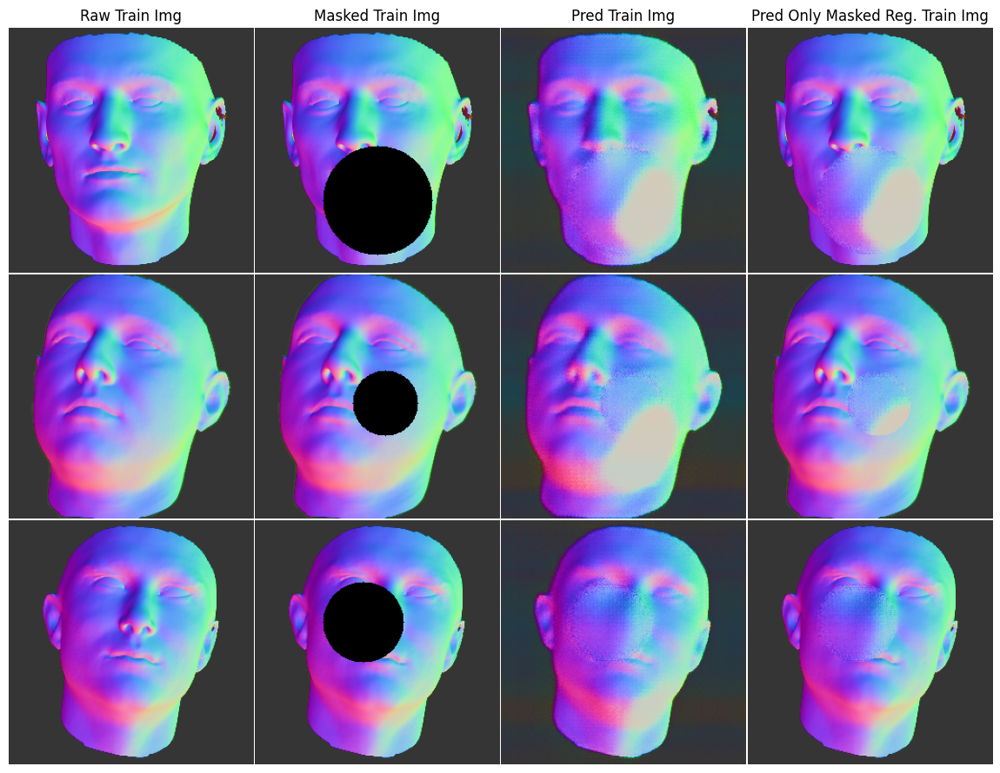

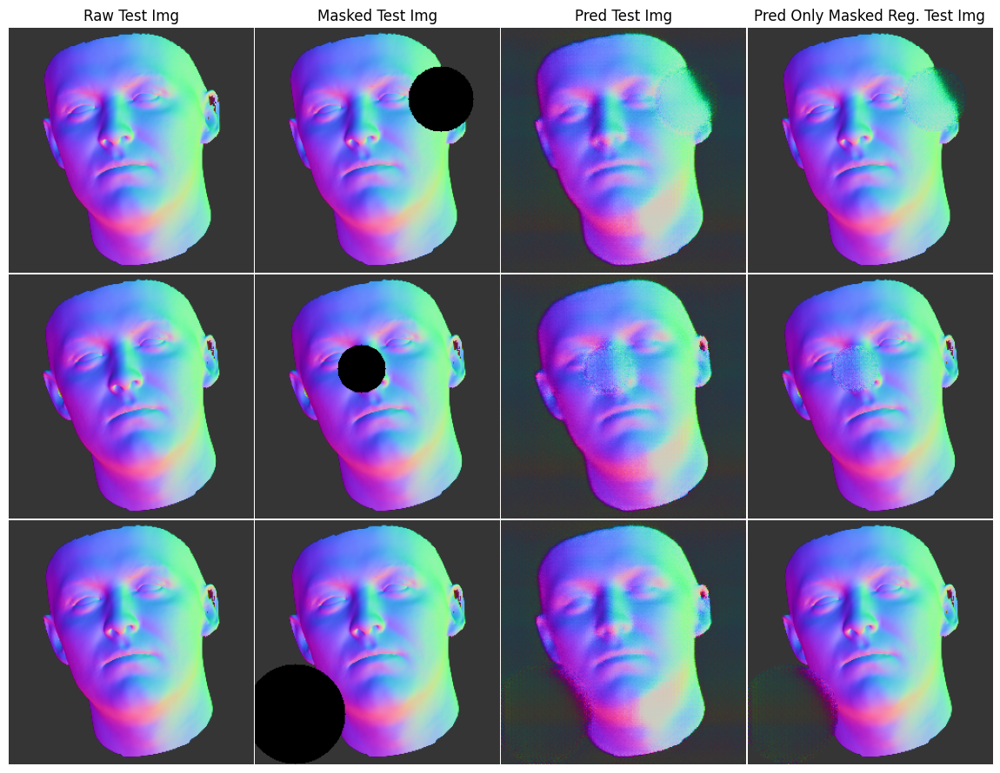

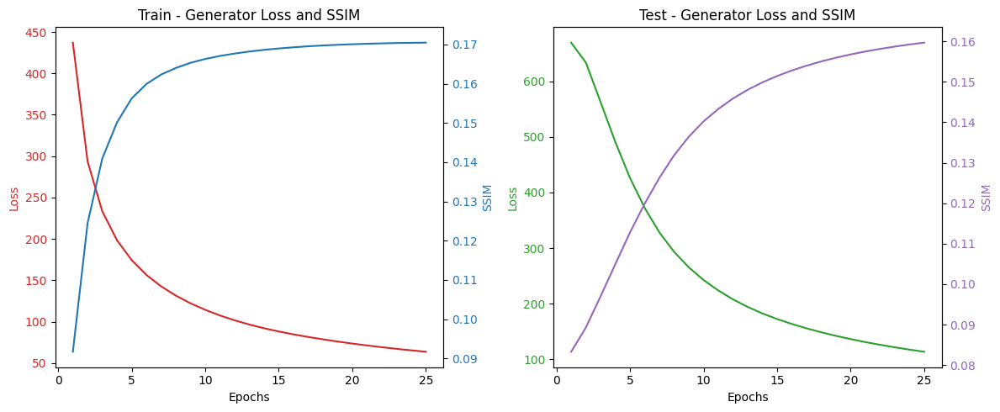

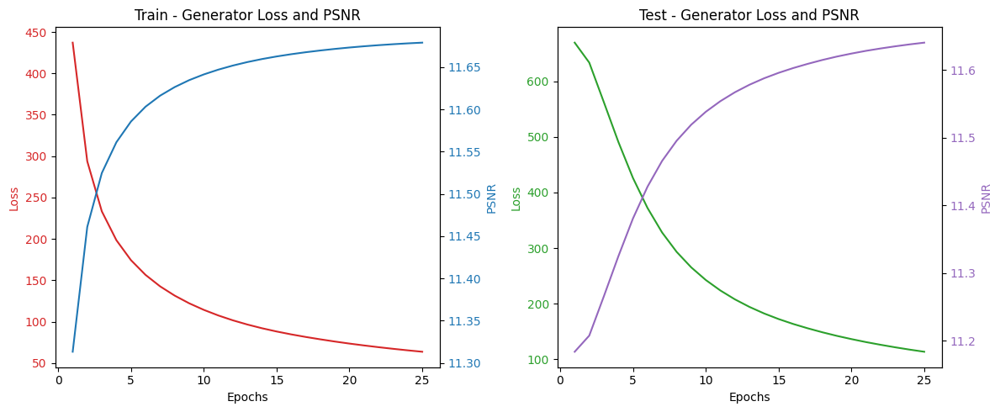

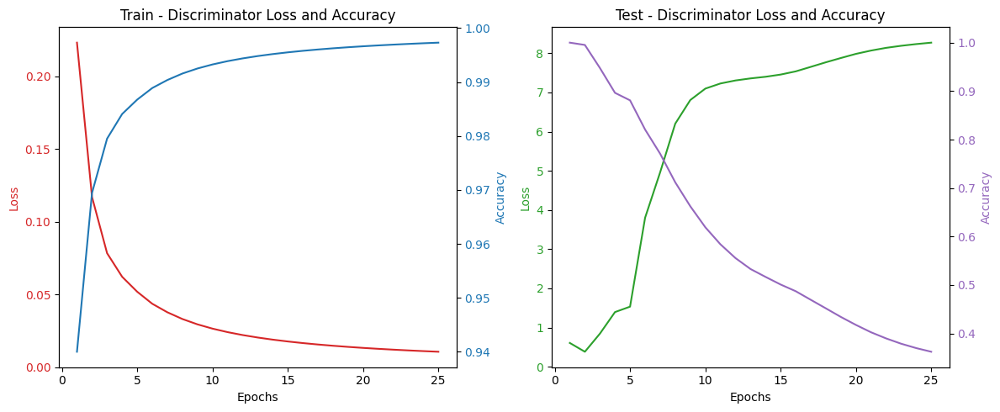

Epoch 26/1000  Train[G_Loss:22.12304 SSIM:17.10% PSNR:11.70 Disc:0.00000 100.000%]  Test[G_Loss:21.19916 SSIM:17.02% PSNR:11.70 Disc:9.17664 14.762%] - 9s  Checkpoint&Models saved (epoch 26)
Epoch 27/1000  Train[G_Loss:21.32544 SSIM:17.05% PSNR:11.70 Disc:0.00000 100.000%]  Test[G_Loss:20.77608 SSIM:16.97% PSNR:11.70 Disc:9.14649 15.238%] - 9s  Checkpoint&Models saved (epoch 27)
Epoch 28/1000  Train[G_Loss:20.50612 SSIM:17.01% PSNR:11.70 Disc:0.00000 100.000%]  Test[G_Loss:20.69822 SSIM:16.85% PSNR:11.70 Disc:9.22430 10.952%] - 8s  Checkpoint&Models saved (epoch 28)
Epoch 29/1000  Train[G_Loss:20.04535 SSIM:16.92% PSNR:11.69 Disc:0.00000 100.000%]  Test[G_Loss:19.98644 SSIM:16.87% PSNR:11.69 Disc:9.21849 10.952%] - 9s  Checkpoint&Models saved (epoch 29)
Epoch 30/1000  Train[G_Loss:19.81339 SSIM:16.90% PSNR:11.69 Disc:0.00000 100.000%]  Test[G_Loss:19.39006 SSIM:16.77% PSNR:11.69 Disc:9.13935 11.429%] - 9s  Checkpoint&Models saved (epoch 30)
Epoch 31/1000  Train[G_Loss:19.79016 SSIM:16.

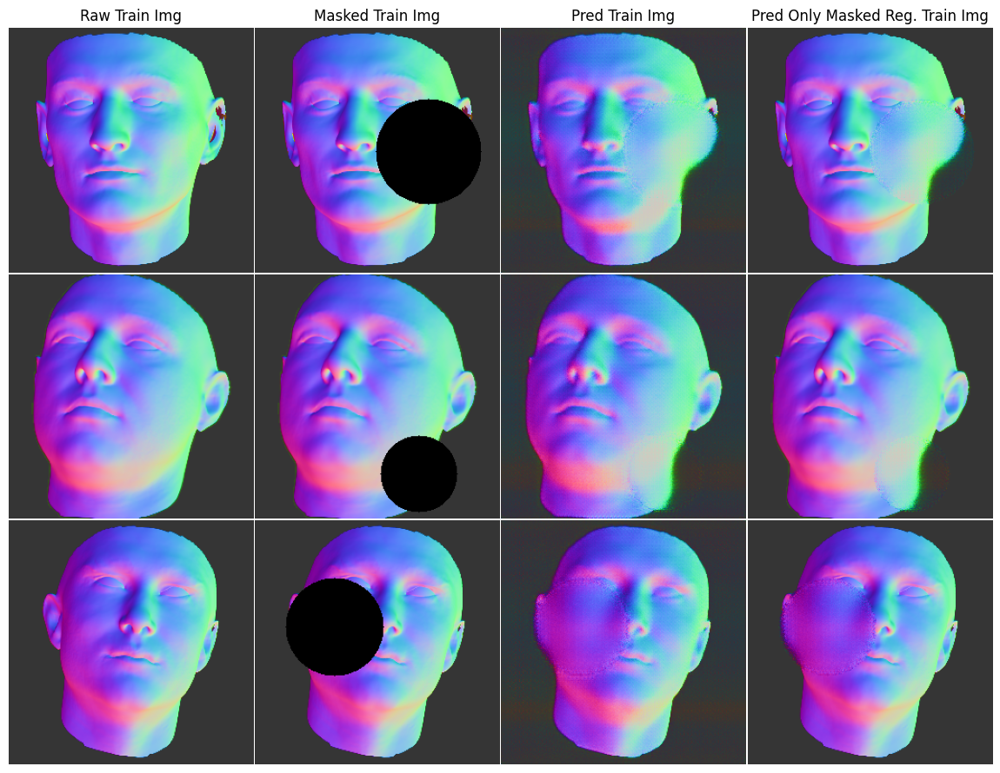

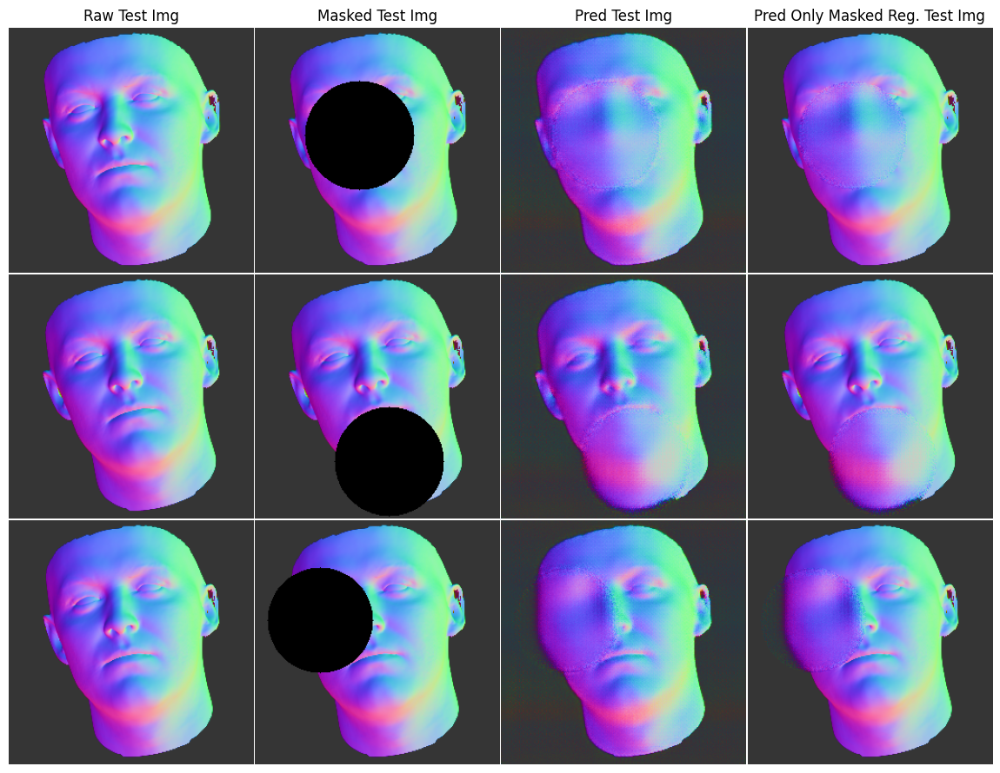

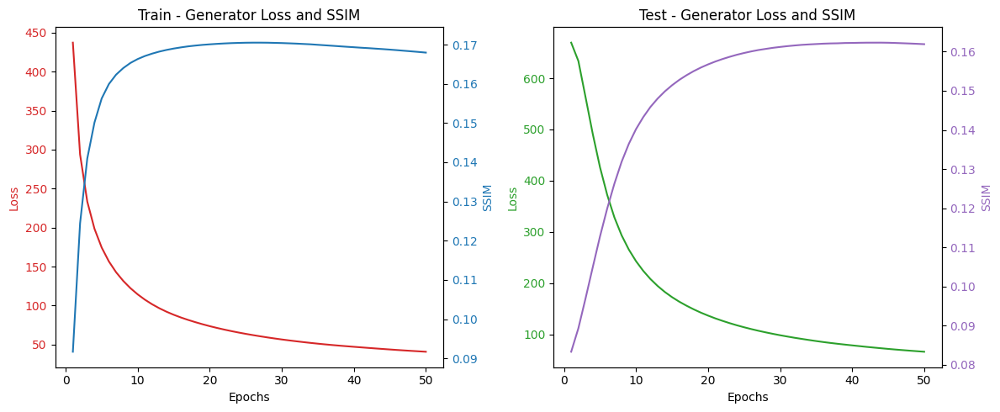

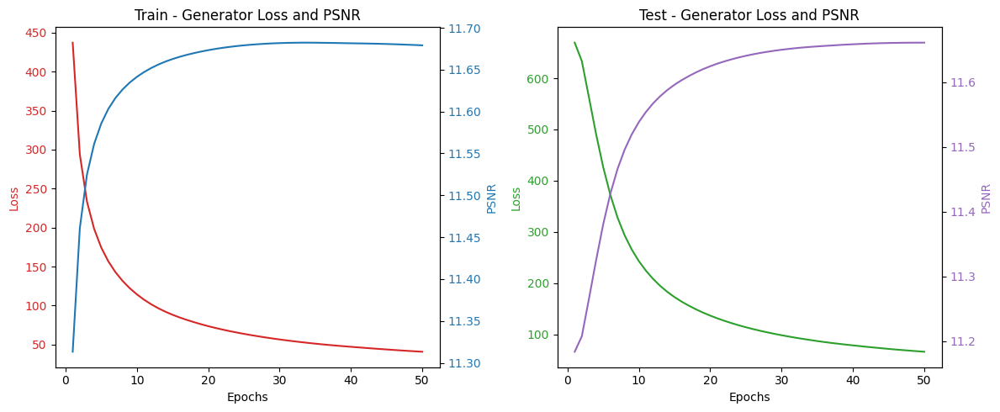

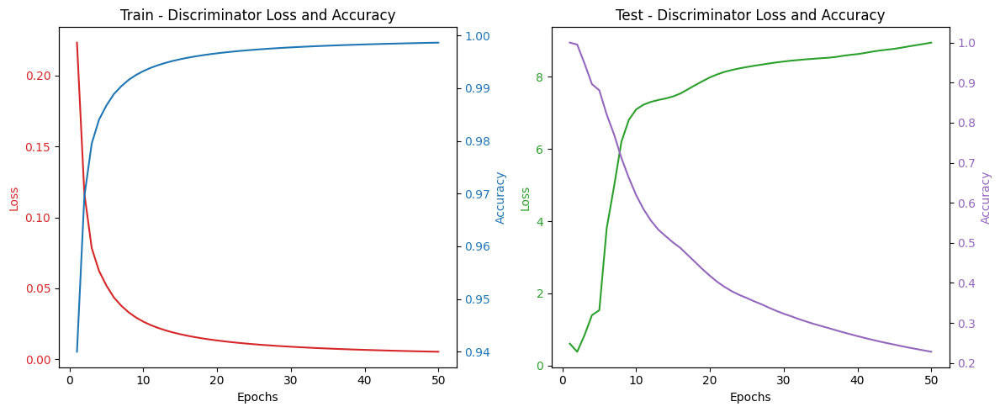

Epoch 51/1000  Train[G_Loss:14.06083 SSIM:15.95% PSNR:11.66 Disc:0.00000 100.000%]  Test[G_Loss:15.63378 SSIM:15.81% PSNR:11.66 Disc:10.55599 7.143%] - 9s  
Epoch 52/1000  Train[G_Loss:13.86793 SSIM:15.99% PSNR:11.66 Disc:0.00000 100.000%]  Test[G_Loss:15.00218 SSIM:15.84% PSNR:11.66 Disc:10.40368 7.143%] - 9s  
Epoch 53/1000  Train[G_Loss:13.26779 SSIM:16.00% PSNR:11.66 Disc:0.00001 100.000%]  Test[G_Loss:15.22524 SSIM:15.92% PSNR:11.66 Disc:10.44761 7.619%] - 9s  
Epoch 54/1000  Train[G_Loss:12.84477 SSIM:15.99% PSNR:11.66 Disc:0.00000 100.000%]  Test[G_Loss:13.65723 SSIM:15.87% PSNR:11.66 Disc:10.39969 8.095%] - 9s  Checkpoint&Models saved (epoch 54)
Epoch 55/1000  Train[G_Loss:12.64676 SSIM:15.89% PSNR:11.66 Disc:0.00000 100.000%]  Test[G_Loss:13.37224 SSIM:15.79% PSNR:11.66 Disc:10.43720 7.619%] - 8s  Checkpoint&Models saved (epoch 55)
Epoch 56/1000  Train[G_Loss:12.15684 SSIM:15.80% PSNR:11.65 Disc:0.00000 100.000%]  Test[G_Loss:12.90500 SSIM:15.67% PSNR:11.66 Disc:10.60953 8.095

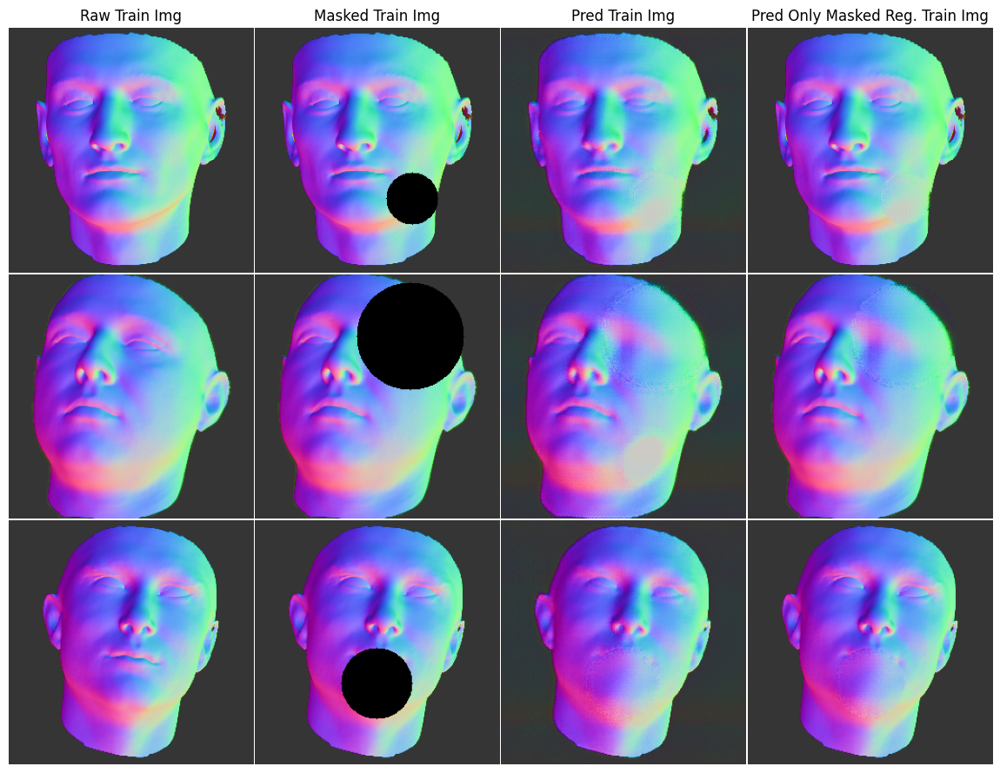

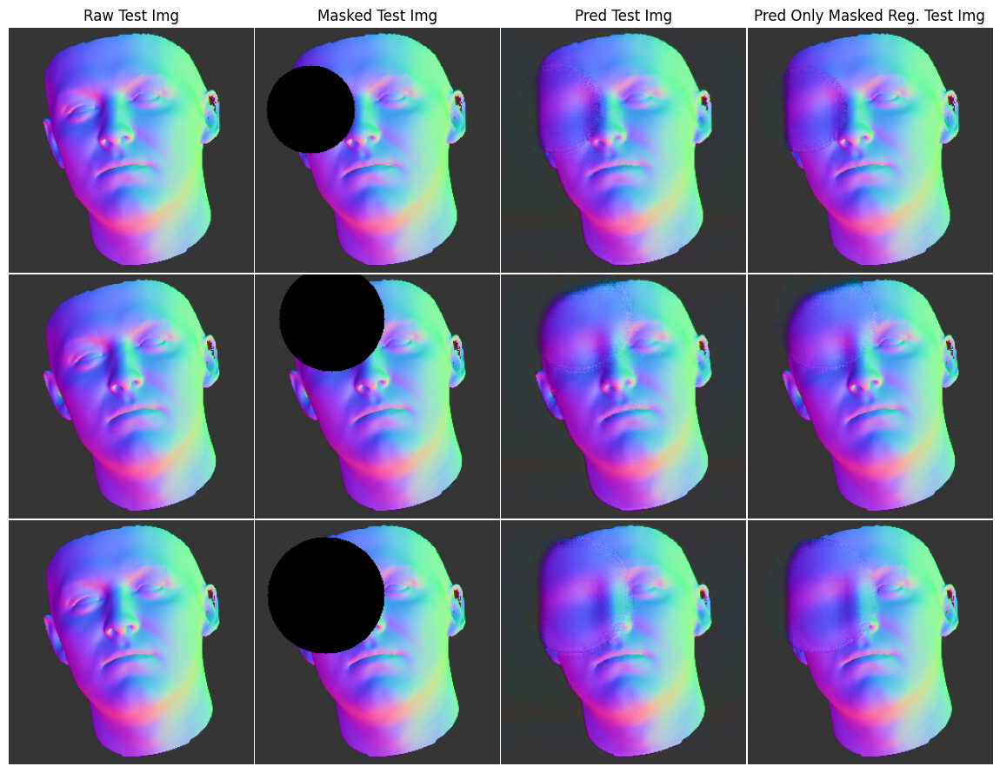

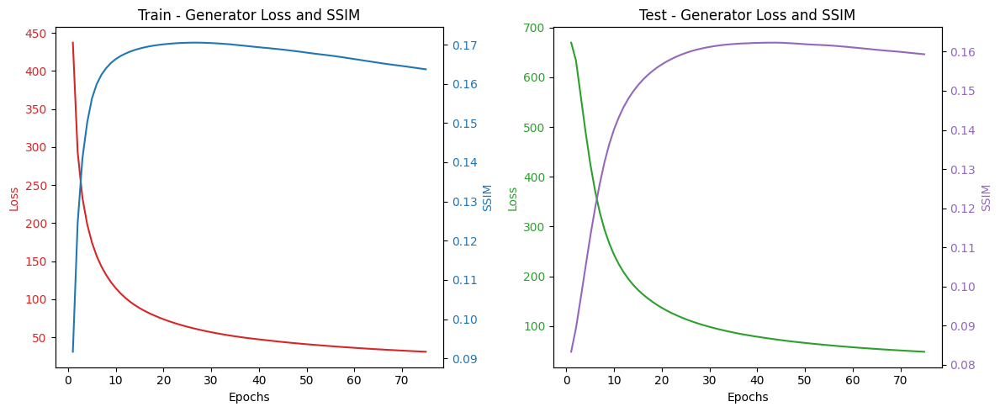

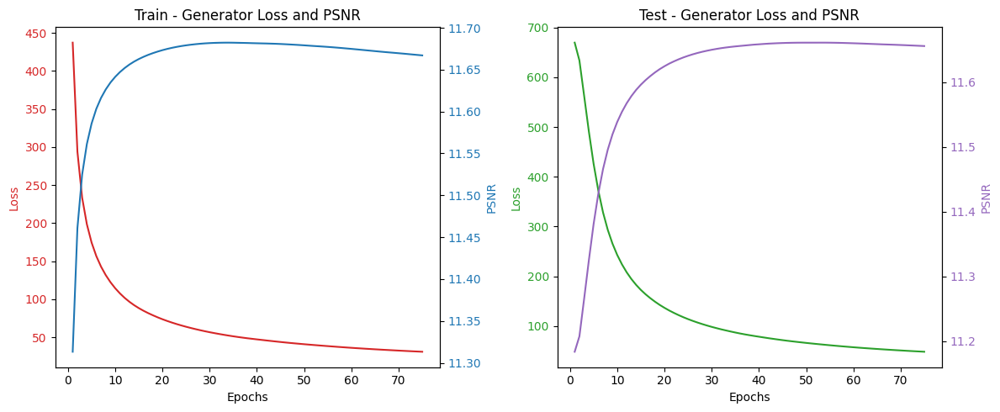

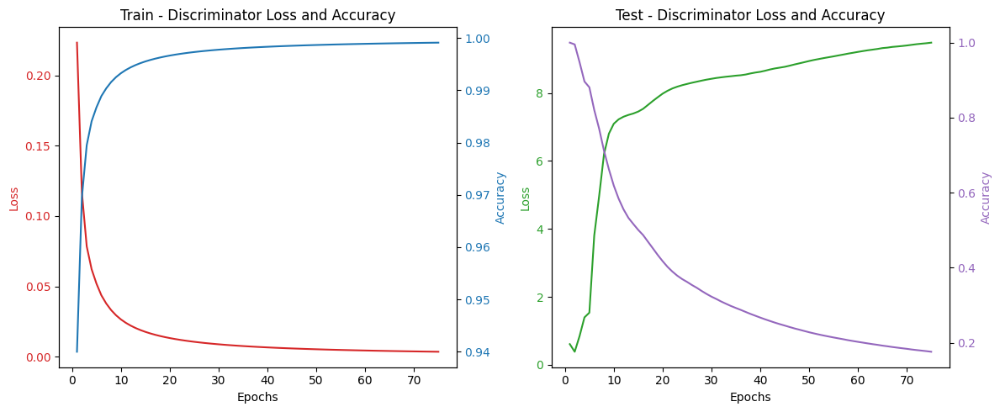

Epoch 76/1000  Train[G_Loss:9.44722 SSIM:15.07% PSNR:11.63 Disc:0.00000 100.000%]  Test[G_Loss:12.69548 SSIM:14.99% PSNR:11.63 Disc:10.80028 6.190%] - 9s  
Epoch 77/1000  Train[G_Loss:9.20151 SSIM:15.06% PSNR:11.63 Disc:0.00000 100.000%]  Test[G_Loss:11.49886 SSIM:14.87% PSNR:11.63 Disc:10.87129 6.667%] - 9s  
Epoch 78/1000  Train[G_Loss:9.27305 SSIM:15.00% PSNR:11.62 Disc:0.00000 100.000%]  Test[G_Loss:11.01774 SSIM:15.02% PSNR:11.63 Disc:10.53534 7.619%] - 9s  Checkpoint&Models saved (epoch 78)
Epoch 79/1000  Train[G_Loss:9.77578 SSIM:15.02% PSNR:11.62 Disc:0.00000 100.000%]  Test[G_Loss:10.83180 SSIM:14.77% PSNR:11.63 Disc:11.25373 5.238%] - 9s  Checkpoint&Models saved (epoch 79)
Epoch 80/1000  Train[G_Loss:9.68774 SSIM:15.07% PSNR:11.63 Disc:0.00000 100.000%]  Test[G_Loss:11.85568 SSIM:15.15% PSNR:11.63 Disc:10.17777 8.095%] - 9s  
Epoch 81/1000  Train[G_Loss:9.20952 SSIM:15.08% PSNR:11.63 Disc:0.00000 100.000%]  Test[G_Loss:12.87275 SSIM:14.88% PSNR:11.63 Disc:10.81145 5.238%] - 9

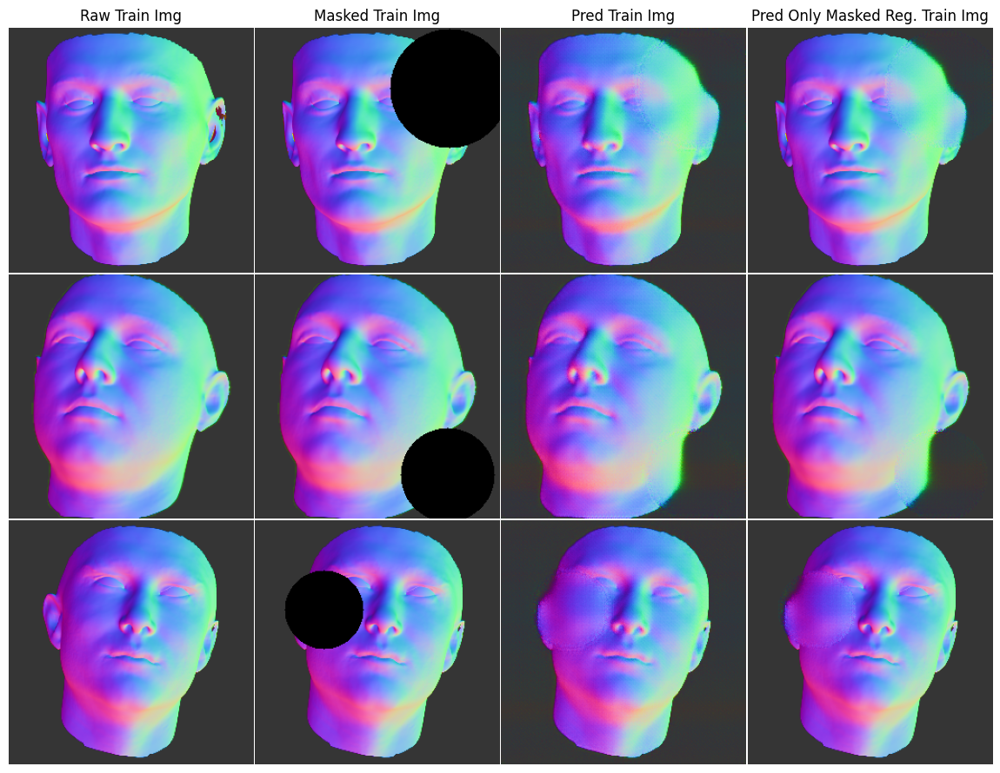

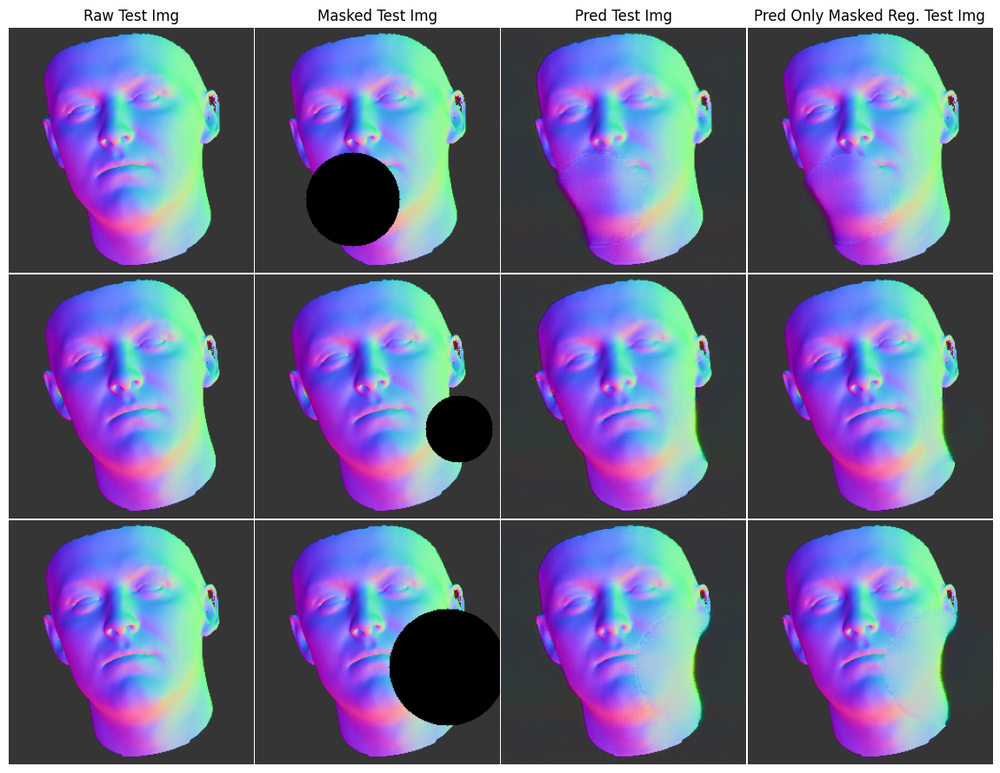

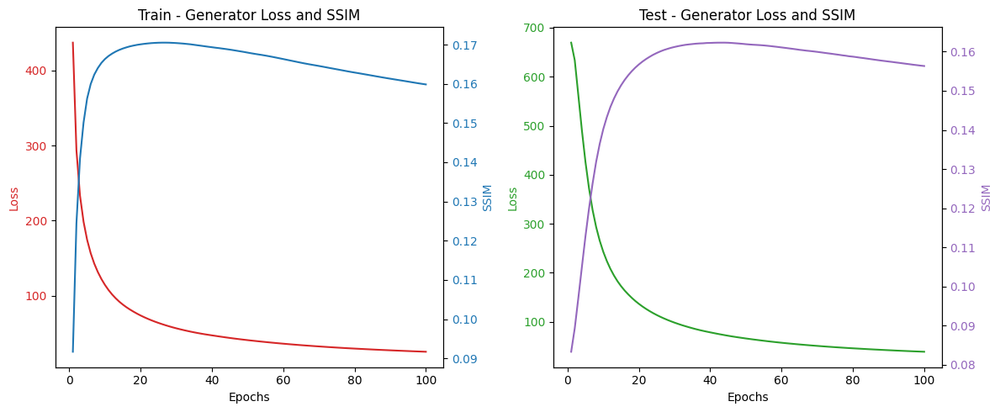

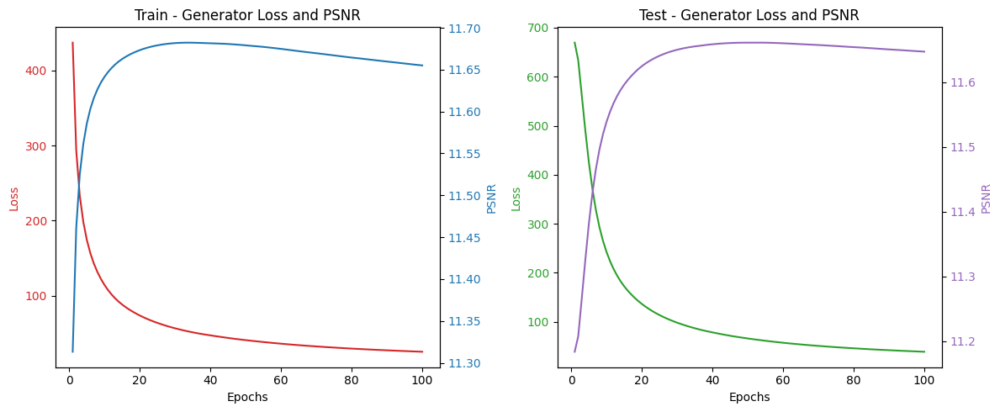

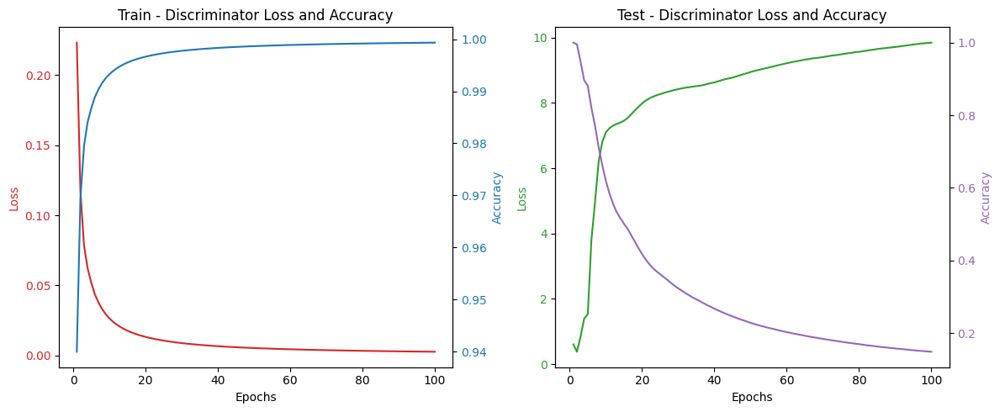

Epoch 101/1000  Train[G_Loss:8.35519 SSIM:14.62% PSNR:11.61 Disc:0.00000 100.000%]  Test[G_Loss:10.74450 SSIM:14.51% PSNR:11.61 Disc:10.89333 6.190%] - 9s  
Epoch 102/1000  Train[G_Loss:7.87248 SSIM:14.60% PSNR:11.61 Disc:0.00000 100.000%]  Test[G_Loss:11.46798 SSIM:14.51% PSNR:11.61 Disc:10.61924 6.190%] - 9s  
Epoch 103/1000  Train[G_Loss:7.59542 SSIM:14.54% PSNR:11.61 Disc:0.00000 100.000%]  Test[G_Loss:10.61061 SSIM:14.48% PSNR:11.61 Disc:10.88705 6.190%] - 9s  
Epoch 104/1000  Train[G_Loss:7.43317 SSIM:14.53% PSNR:11.61 Disc:0.00000 100.000%]  Test[G_Loss:11.14296 SSIM:14.38% PSNR:11.61 Disc:11.02711 5.714%] - 9s  
Epoch 105/1000  Train[G_Loss:7.53335 SSIM:14.51% PSNR:11.61 Disc:0.00000 100.000%]  Test[G_Loss:10.54897 SSIM:14.60% PSNR:11.61 Disc:10.42145 7.619%] - 9s  
Epoch 106/1000  Train[G_Loss:7.71252 SSIM:14.60% PSNR:11.61 Disc:0.00000 100.000%]  Test[G_Loss:10.57621 SSIM:14.54% PSNR:11.61 Disc:10.93209 6.190%] - 8s  
Epoch 107/1000  Train[G_Loss:7.75682 SSIM:14.63% PSNR:11.6

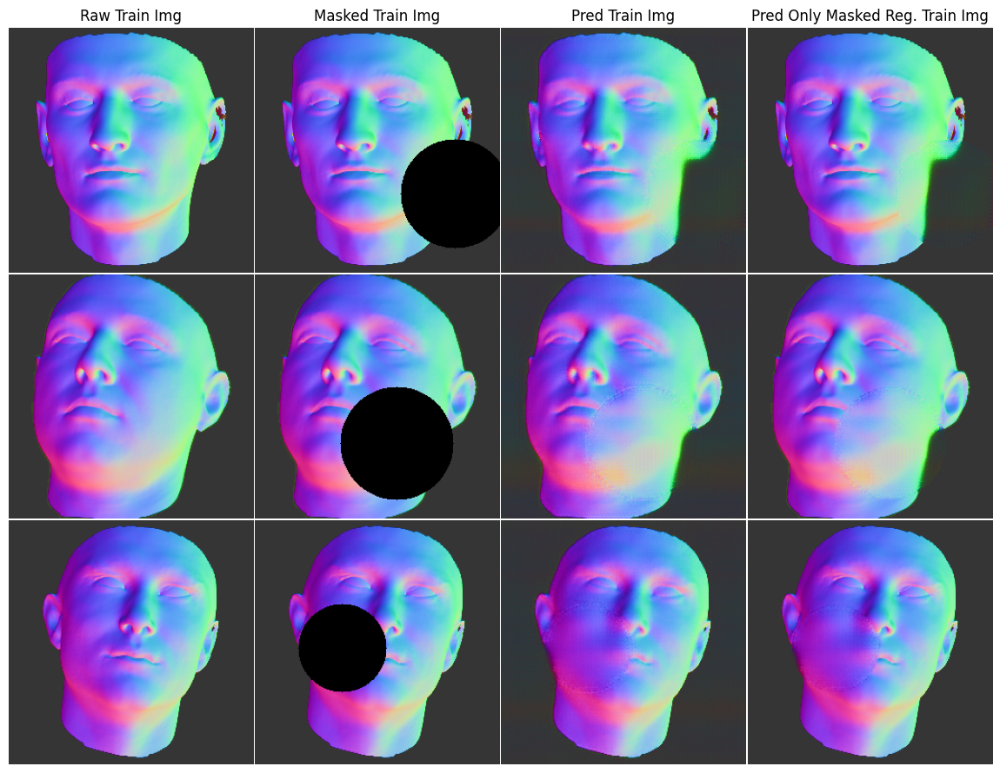

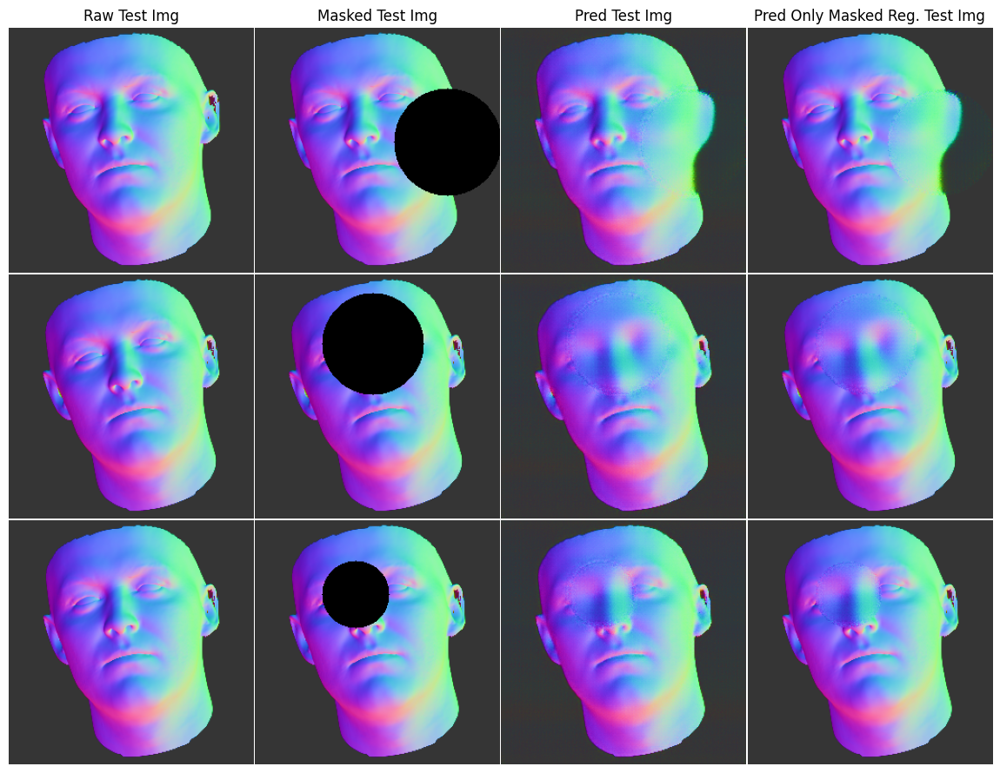

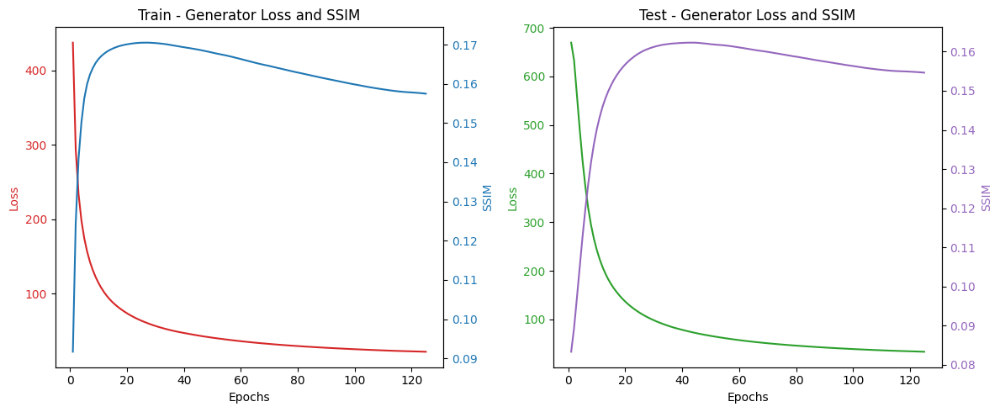

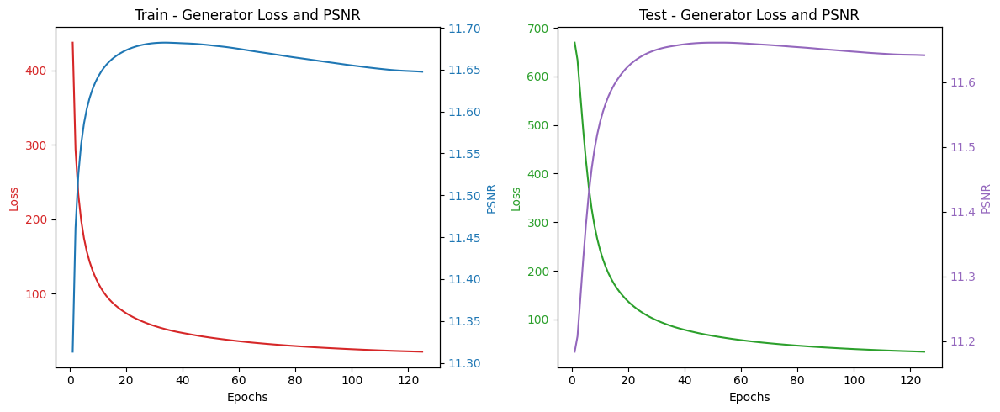

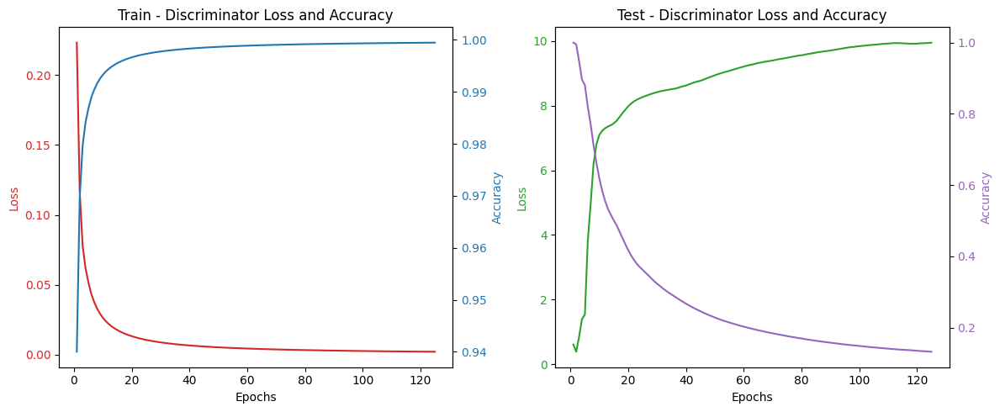

Epoch 126/1000  Train[G_Loss:7.55702 SSIM:14.73% PSNR:11.62 Disc:0.00000 100.000%]  Test[G_Loss:11.27749 SSIM:14.57% PSNR:11.62 Disc:10.95631 5.238%] - 9s  
Epoch 127/1000  Train[G_Loss:7.22595 SSIM:14.73% PSNR:11.62 Disc:0.00000 100.000%]  Test[G_Loss:10.36351 SSIM:14.45% PSNR:11.62 Disc:11.23392 5.238%] - 9s  
Epoch 128/1000  Train[G_Loss:7.44382 SSIM:14.65% PSNR:11.61 Disc:0.00000 100.000%]  Test[G_Loss:9.06648 SSIM:14.42% PSNR:11.62 Disc:11.40642 5.714%] - 9s  Checkpoint&Models saved (epoch 128)
Epoch 129/1000  Train[G_Loss:7.22289 SSIM:14.61% PSNR:11.61 Disc:0.00000 100.000%]  Test[G_Loss:10.08174 SSIM:14.40% PSNR:11.62 Disc:11.52223 5.714%] - 9s  
Epoch 130/1000  Train[G_Loss:7.11559 SSIM:14.54% PSNR:11.61 Disc:0.00000 100.000%]  Test[G_Loss:9.34892 SSIM:14.42% PSNR:11.61 Disc:11.34194 6.190%] - 9s  
Epoch 131/1000  Train[G_Loss:6.89270 SSIM:14.46% PSNR:11.61 Disc:0.00000 100.000%]  Test[G_Loss:9.64309 SSIM:14.46% PSNR:11.61 Disc:11.21008 6.190%] - 9s  
Epoch 132/1000  Train[G_Lo

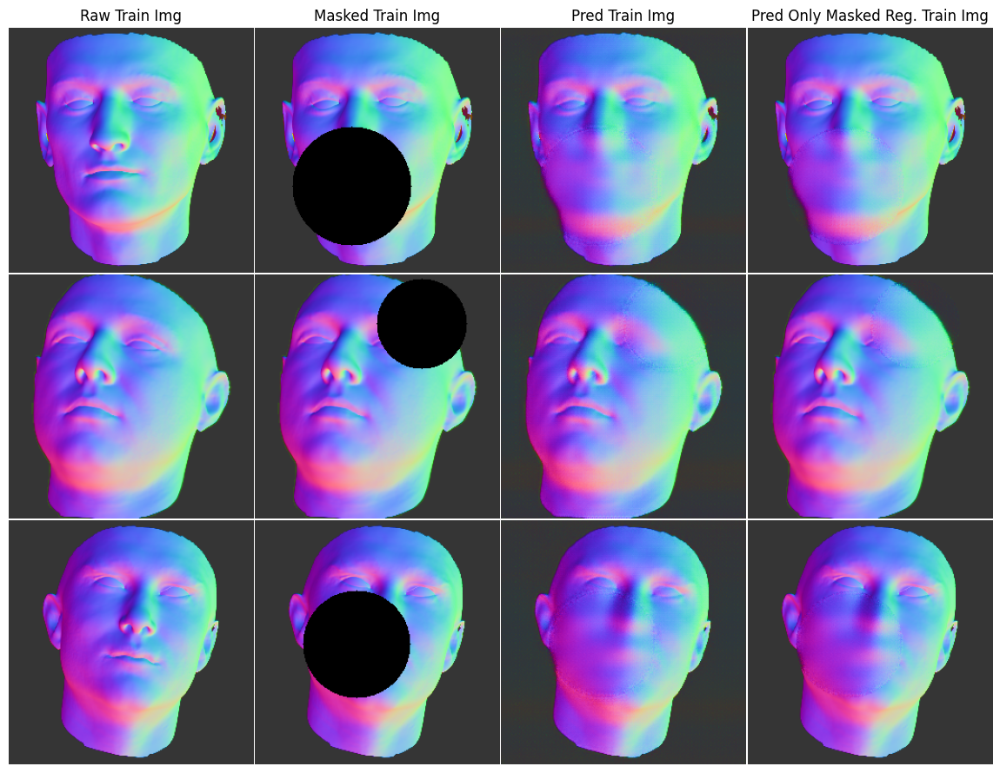

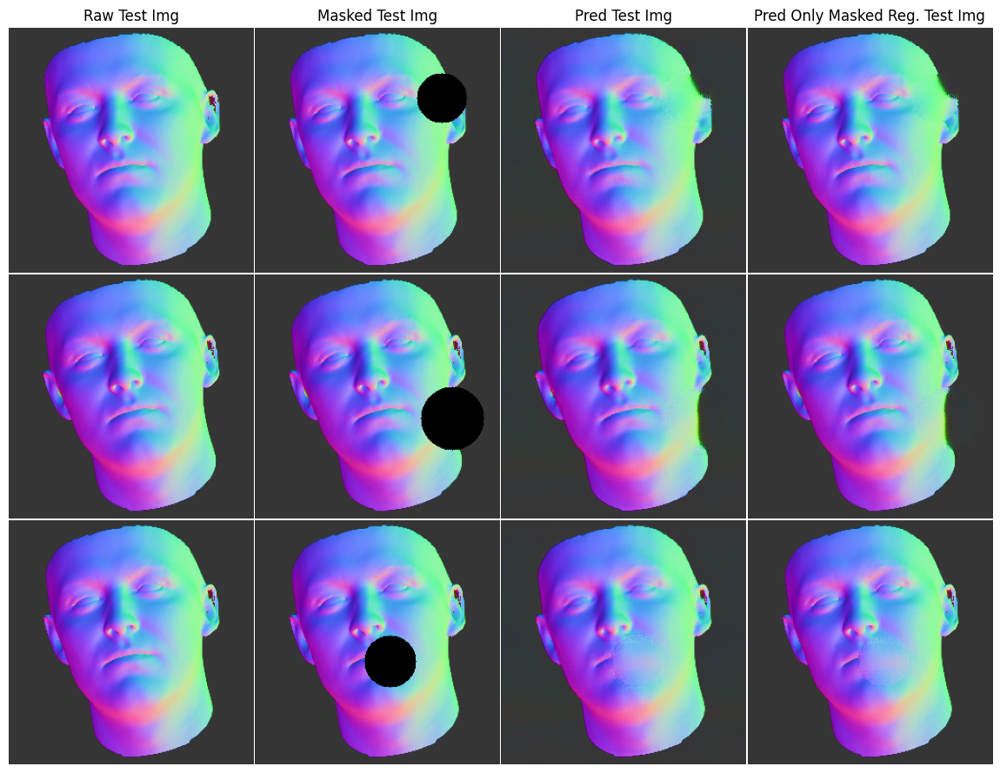

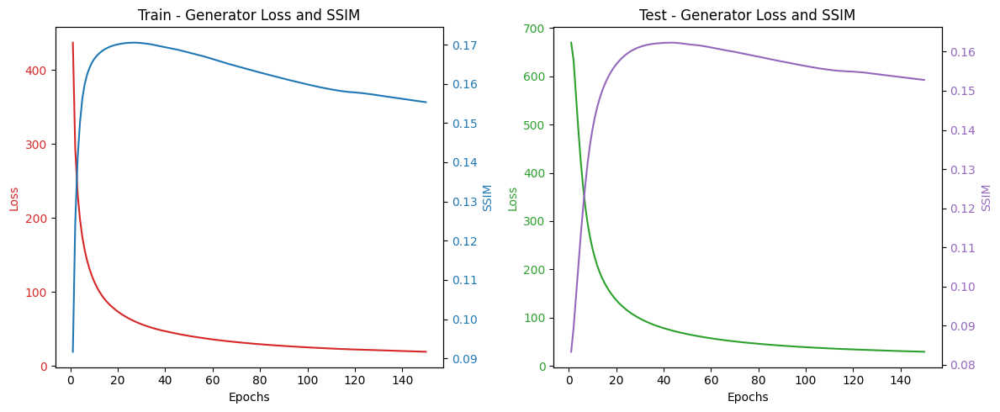

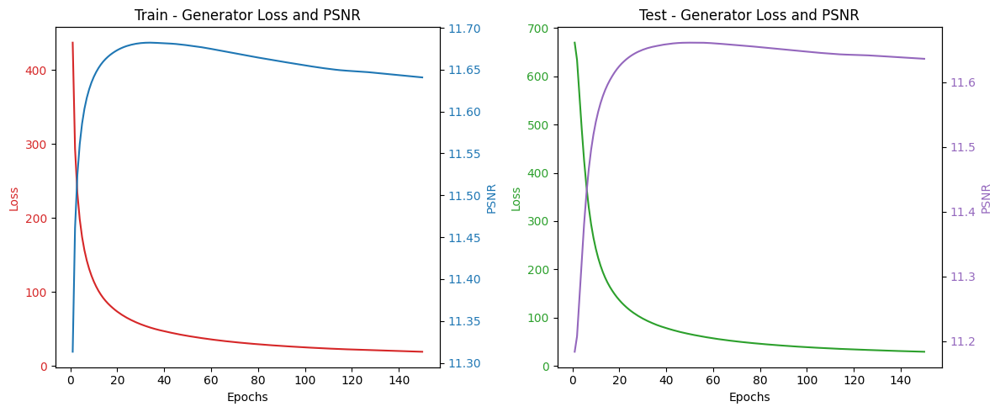

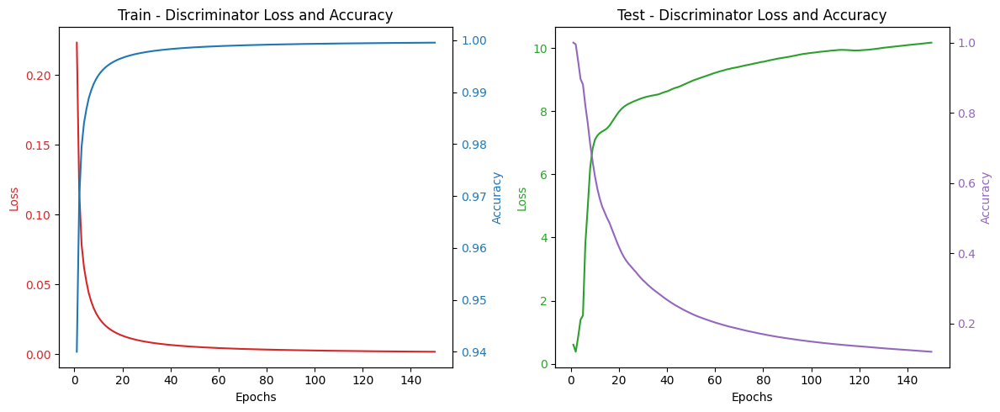

Epoch 151/1000  Train[G_Loss:6.20343 SSIM:14.32% PSNR:11.60 Disc:0.00000 100.000%]  Test[G_Loss:8.69531 SSIM:14.27% PSNR:11.60 Disc:10.99458 5.714%] - 9s  
Epoch 152/1000  Train[G_Loss:6.09853 SSIM:14.27% PSNR:11.60 Disc:0.00000 100.000%]  Test[G_Loss:9.95426 SSIM:14.22% PSNR:11.60 Disc:11.03287 5.714%] - 8s  
Epoch 153/1000  Train[G_Loss:6.29618 SSIM:14.21% PSNR:11.60 Disc:0.00000 100.000%]  Test[G_Loss:8.80289 SSIM:14.24% PSNR:11.60 Disc:11.10346 5.714%] - 9s  
Epoch 154/1000  Train[G_Loss:6.07857 SSIM:14.24% PSNR:11.60 Disc:0.00000 100.000%]  Test[G_Loss:9.24842 SSIM:14.17% PSNR:11.60 Disc:11.26508 5.714%] - 9s  
Epoch 155/1000  Train[G_Loss:6.02957 SSIM:14.19% PSNR:11.60 Disc:0.00000 100.000%]  Test[G_Loss:10.02036 SSIM:14.09% PSNR:11.60 Disc:11.27584 5.714%] - 9s  
Epoch 156/1000  Train[G_Loss:6.09480 SSIM:14.16% PSNR:11.59 Disc:0.00000 100.000%]  Test[G_Loss:8.84220 SSIM:14.03% PSNR:11.60 Disc:11.42287 5.238%] - 9s  
Epoch 157/1000  Train[G_Loss:6.05750 SSIM:14.16% PSNR:11.59 Dis

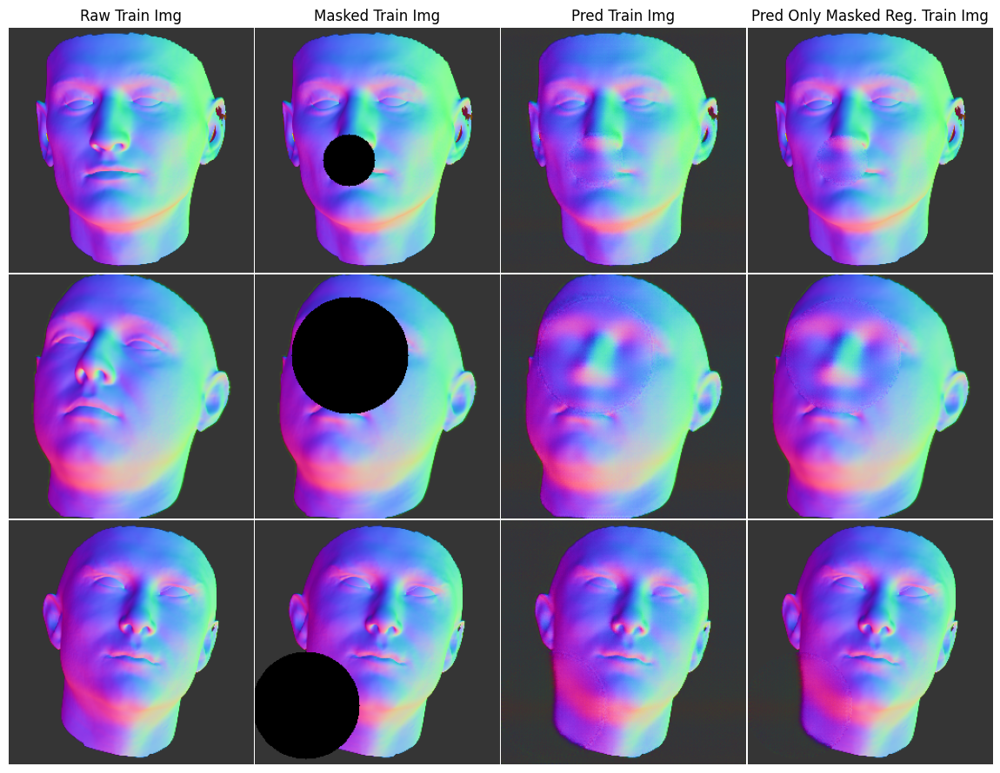

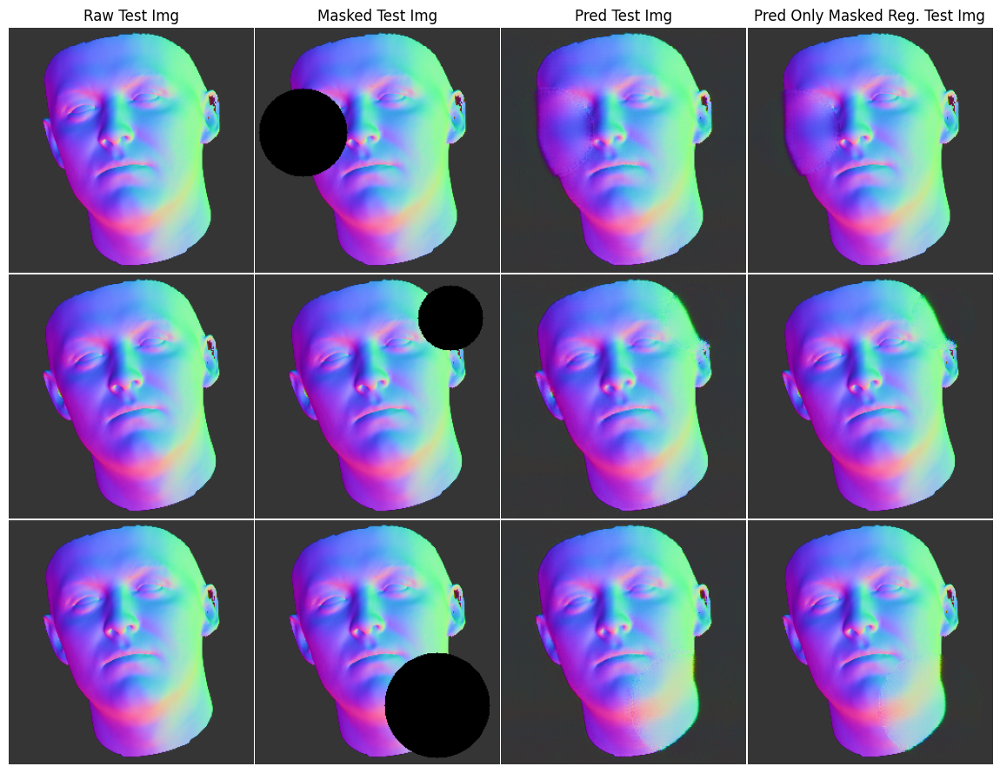

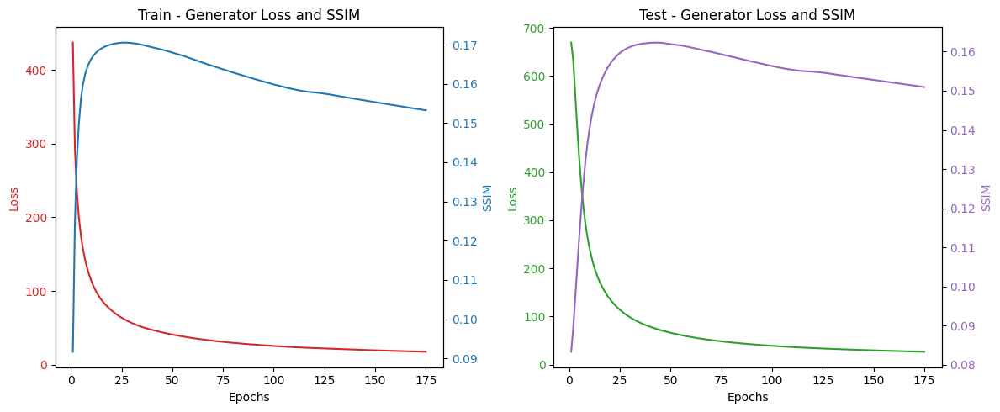

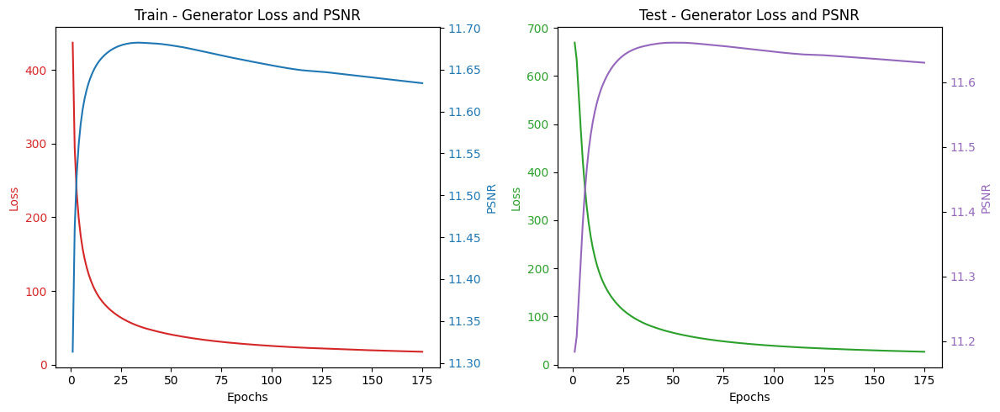

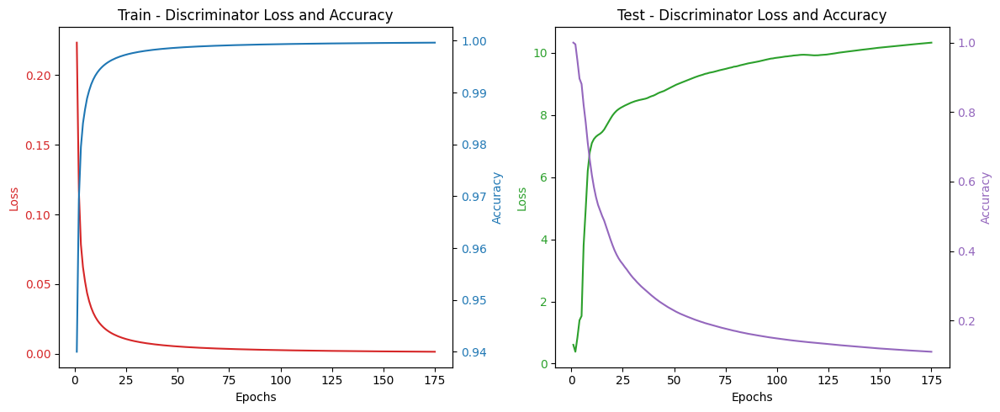

Epoch 176/1000  Train[G_Loss:5.45776 SSIM:13.88% PSNR:11.59 Disc:0.00000 100.000%]  Test[G_Loss:9.19115 SSIM:13.83% PSNR:11.59 Disc:11.20408 5.238%] - 9s  
Epoch 177/1000  Train[G_Loss:5.51916 SSIM:13.84% PSNR:11.58 Disc:0.00000 100.000%]  Test[G_Loss:9.62375 SSIM:13.77% PSNR:11.58 Disc:11.37842 5.238%] - 9s  
Epoch 178/1000  Train[G_Loss:5.38252 SSIM:13.84% PSNR:11.58 Disc:0.00000 100.000%]  Test[G_Loss:9.07480 SSIM:13.72% PSNR:11.59 Disc:11.57891 5.238%] - 9s  
Epoch 179/1000  Train[G_Loss:5.50132 SSIM:13.86% PSNR:11.58 Disc:0.00000 100.000%]  Test[G_Loss:8.39451 SSIM:13.80% PSNR:11.59 Disc:11.34319 5.238%] - 9s  
Epoch 180/1000  Train[G_Loss:5.56437 SSIM:13.92% PSNR:11.59 Disc:0.00000 100.000%]  Test[G_Loss:9.37072 SSIM:13.82% PSNR:11.59 Disc:11.27623 5.238%] - 9s  
Epoch 181/1000  Train[G_Loss:5.74987 SSIM:13.94% PSNR:11.59 Disc:0.00000 100.000%]  Test[G_Loss:8.50256 SSIM:13.88% PSNR:11.59 Disc:11.07028 5.238%] - 9s  
Epoch 182/1000  Train[G_Loss:5.32037 SSIM:13.97% PSNR:11.59 Disc

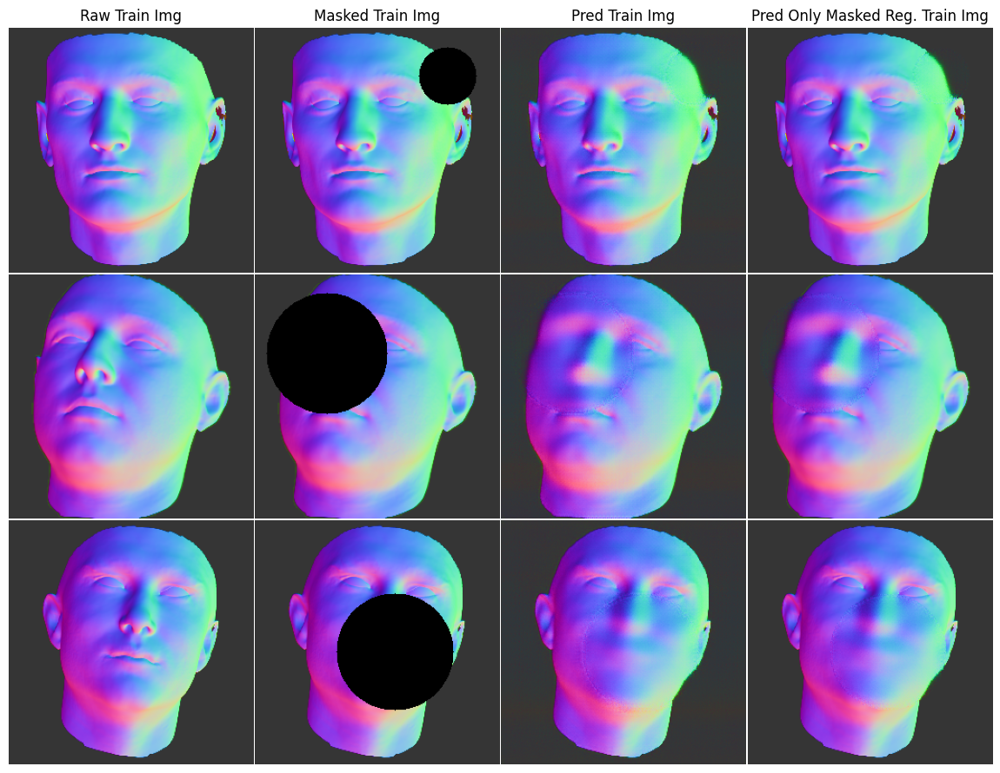

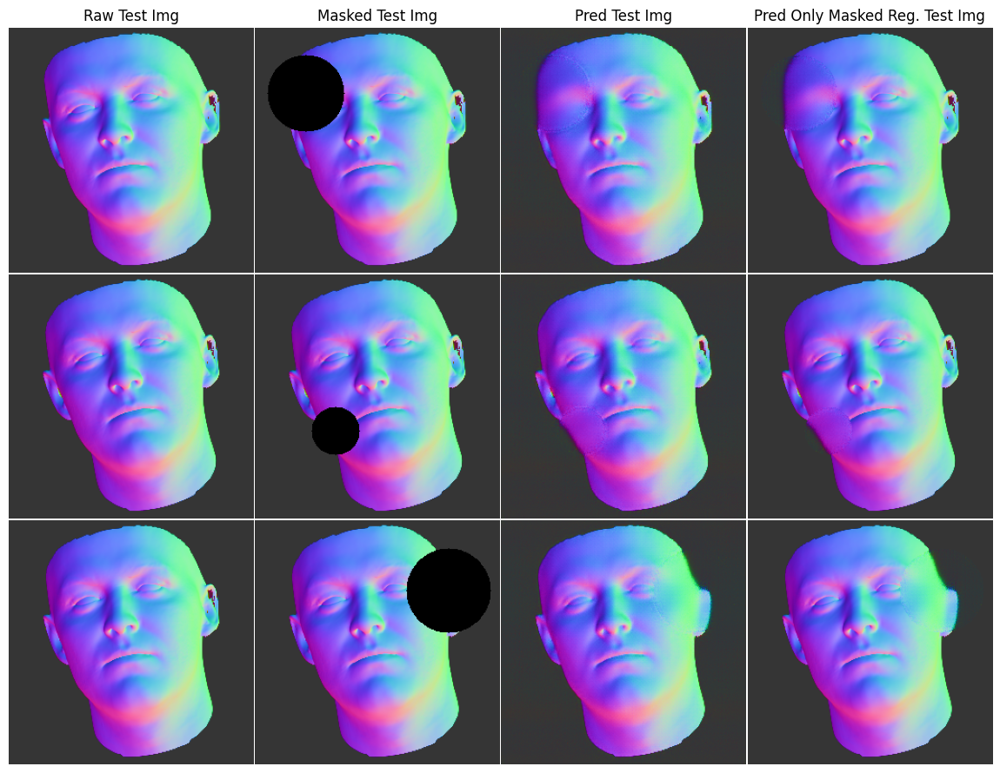

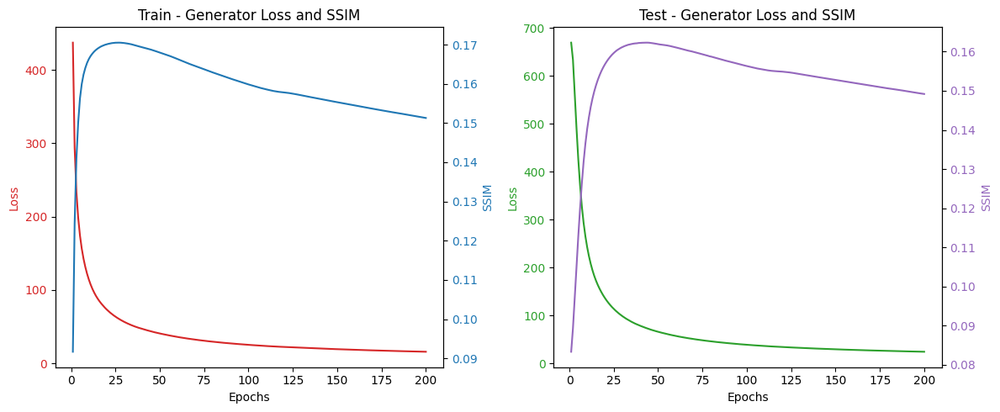

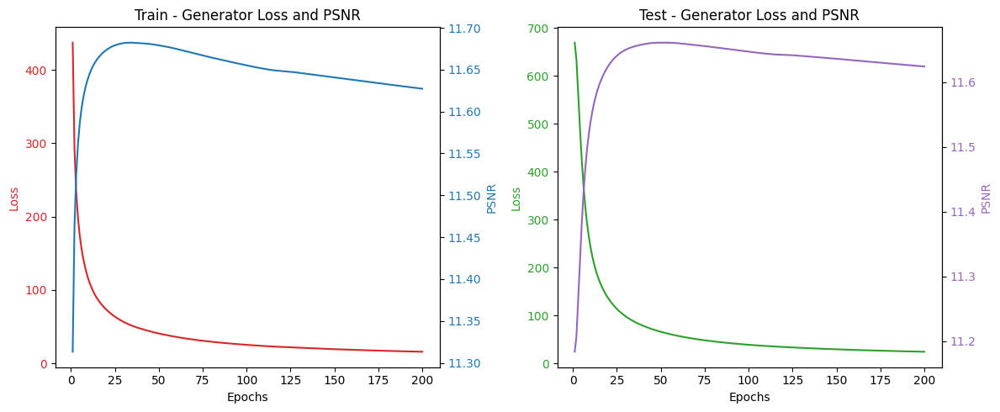

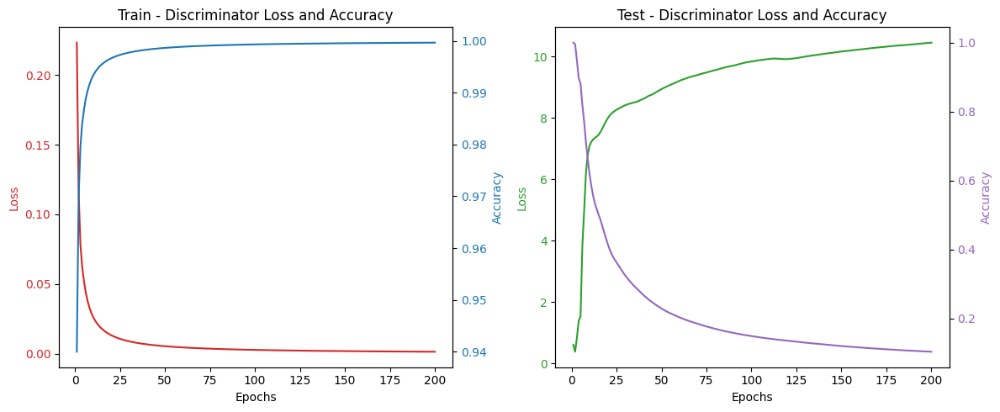

Epoch 201/1000  Train[G_Loss:4.96240 SSIM:13.64% PSNR:11.58 Disc:0.00000 100.000%]  Test[G_Loss:8.92452 SSIM:13.61% PSNR:11.58 Disc:11.16250 5.238%] - 9s  
Epoch 202/1000  Train[G_Loss:4.87082 SSIM:13.61% PSNR:11.58 Disc:0.00000 100.000%]  Test[G_Loss:8.18146 SSIM:13.62% PSNR:11.58 Disc:11.03889 5.238%] - 8s  
Epoch 203/1000  Train[G_Loss:4.91887 SSIM:13.59% PSNR:11.58 Disc:0.00000 100.000%]  Test[G_Loss:8.54250 SSIM:13.56% PSNR:11.58 Disc:11.24190 5.238%] - 9s  
Epoch 204/1000  Train[G_Loss:5.01810 SSIM:13.59% PSNR:11.57 Disc:0.00000 100.000%]  Test[G_Loss:8.88121 SSIM:13.73% PSNR:11.58 Disc:10.65622 5.714%] - 9s  
Epoch 205/1000  Train[G_Loss:4.98867 SSIM:13.63% PSNR:11.58 Disc:0.00000 100.000%]  Test[G_Loss:8.63026 SSIM:13.64% PSNR:11.58 Disc:11.08922 5.714%] - 9s  
Epoch 206/1000  Train[G_Loss:5.03377 SSIM:13.64% PSNR:11.58 Disc:0.00000 100.000%]  Test[G_Loss:7.94890 SSIM:13.69% PSNR:11.58 Disc:11.04905 5.238%] - 9s  Checkpoint&Models saved (epoch 206)
Epoch 207/1000  Train[G_Loss:

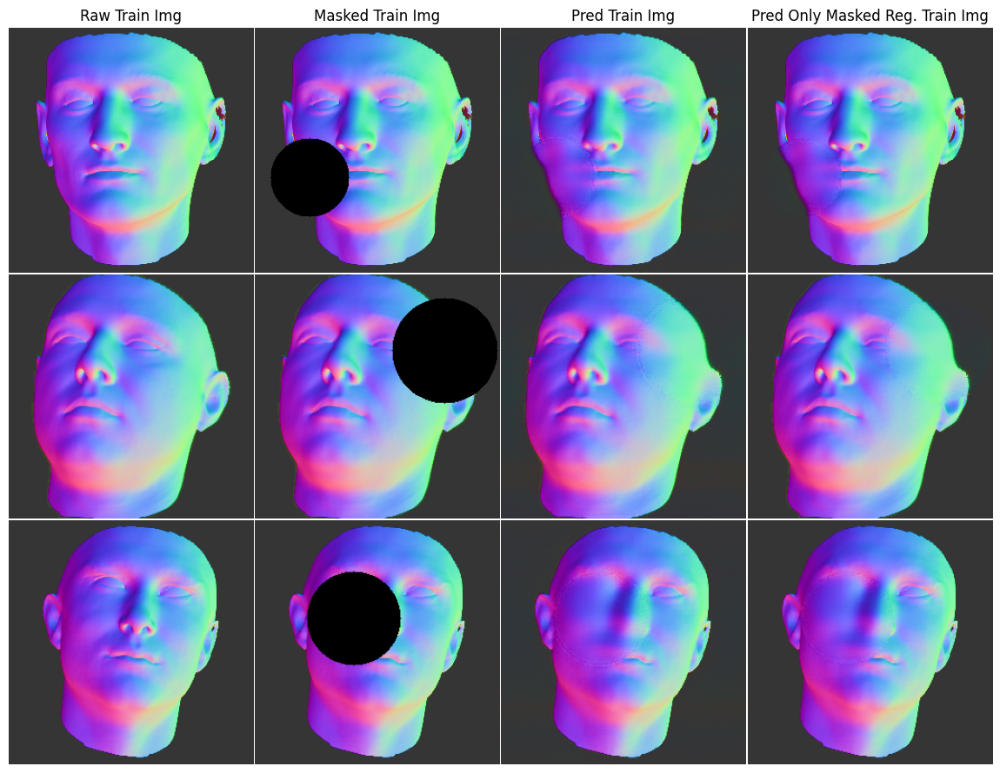

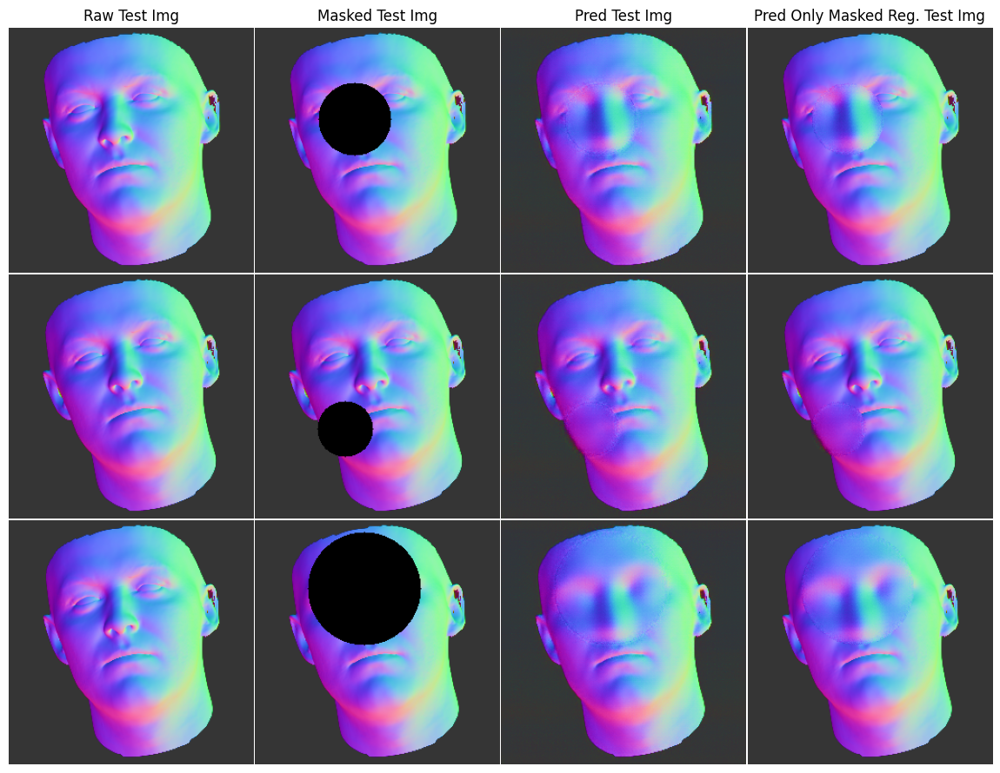

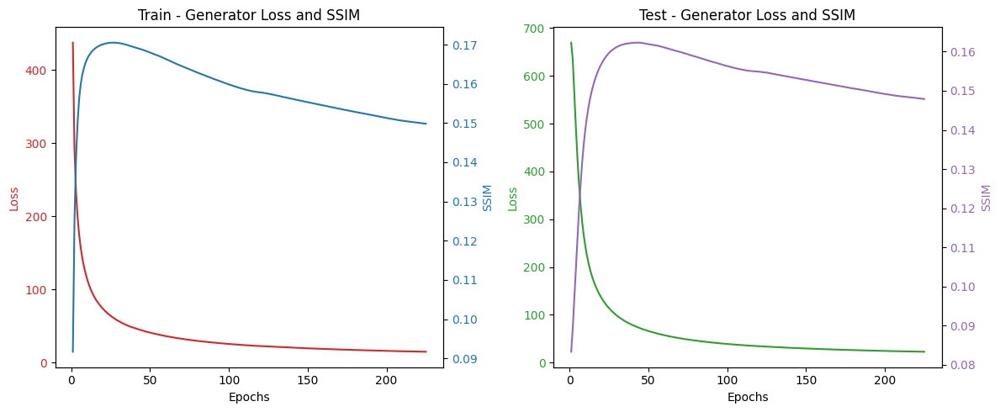

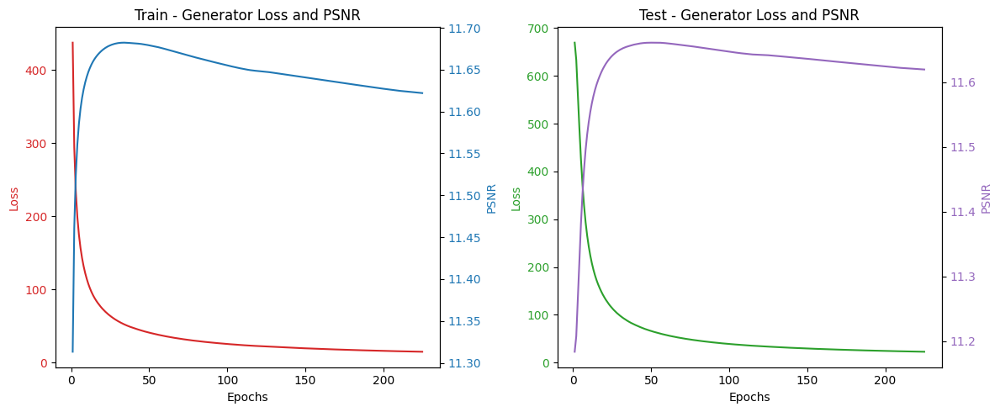

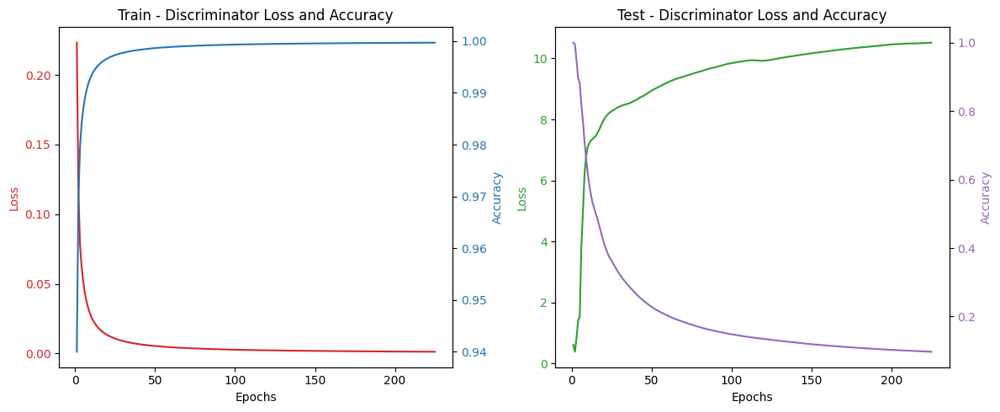

Epoch 226/1000  Train[G_Loss:4.67451 SSIM:13.78% PSNR:11.58 Disc:0.00000 100.000%]  Test[G_Loss:8.15311 SSIM:13.68% PSNR:11.58 Disc:11.31819 5.238%] - 9s  
Epoch 227/1000  Train[G_Loss:4.60060 SSIM:13.76% PSNR:11.58 Disc:0.00000 100.000%]  Test[G_Loss:7.61923 SSIM:13.69% PSNR:11.58 Disc:11.37523 5.238%] - 9s  Checkpoint&Models saved (epoch 227)
Epoch 228/1000  Train[G_Loss:4.48364 SSIM:13.72% PSNR:11.58 Disc:0.00000 100.000%]  Test[G_Loss:7.98149 SSIM:13.66% PSNR:11.58 Disc:11.26580 5.238%] - 9s  
Epoch 229/1000  Train[G_Loss:4.50483 SSIM:13.69% PSNR:11.58 Disc:0.00000 100.000%]  Test[G_Loss:9.32776 SSIM:13.63% PSNR:11.58 Disc:11.23223 5.238%] - 9s  
Epoch 230/1000  Train[G_Loss:4.62739 SSIM:13.68% PSNR:11.57 Disc:0.00000 100.000%]  Test[G_Loss:7.66143 SSIM:13.66% PSNR:11.58 Disc:11.16951 5.238%] - 9s  
Epoch 231/1000  Train[G_Loss:4.43752 SSIM:13.66% PSNR:11.57 Disc:0.00000 100.000%]  Test[G_Loss:8.51864 SSIM:13.60% PSNR:11.58 Disc:11.14701 5.238%] - 8s  
Epoch 232/1000  Train[G_Loss:

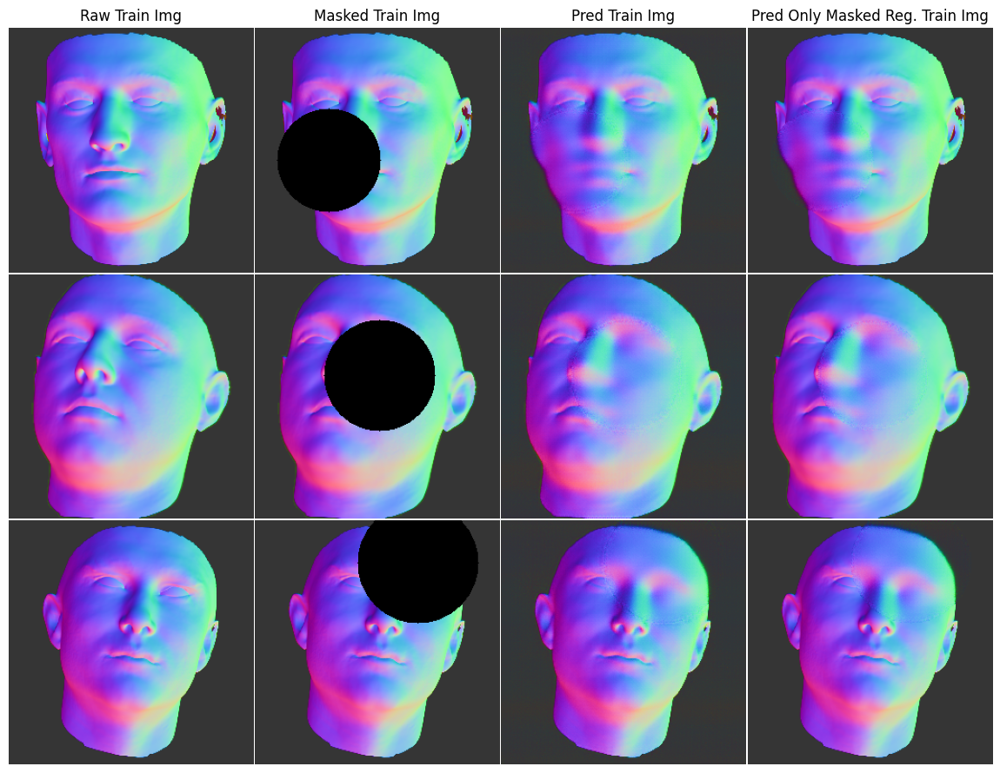

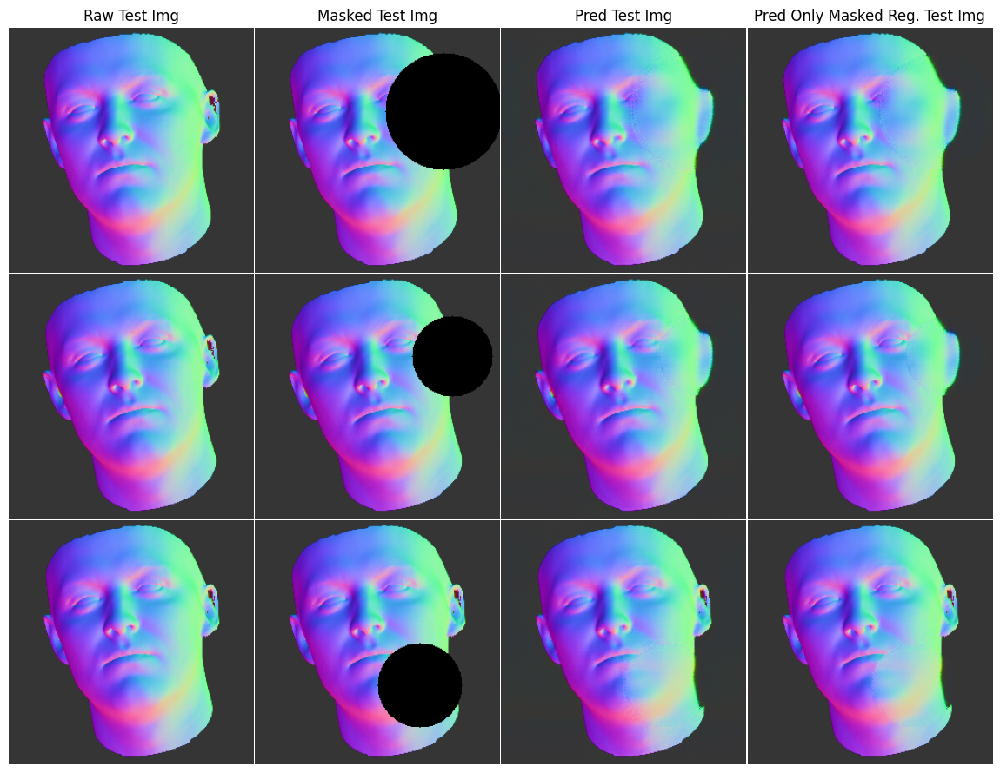

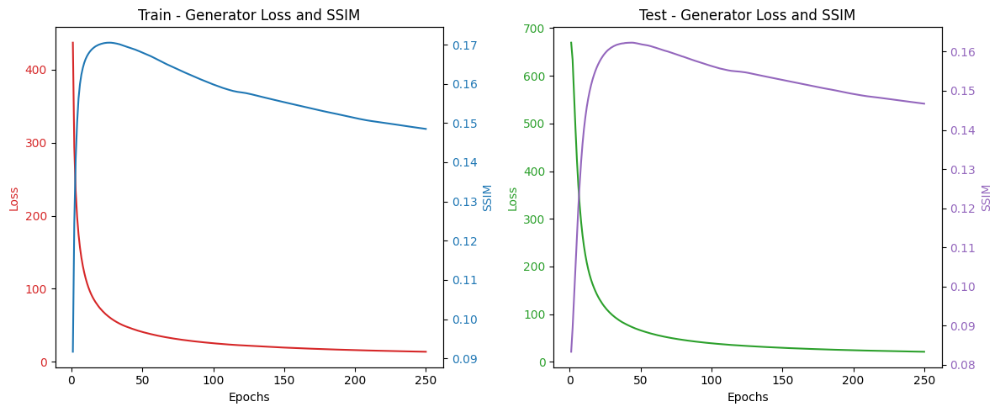

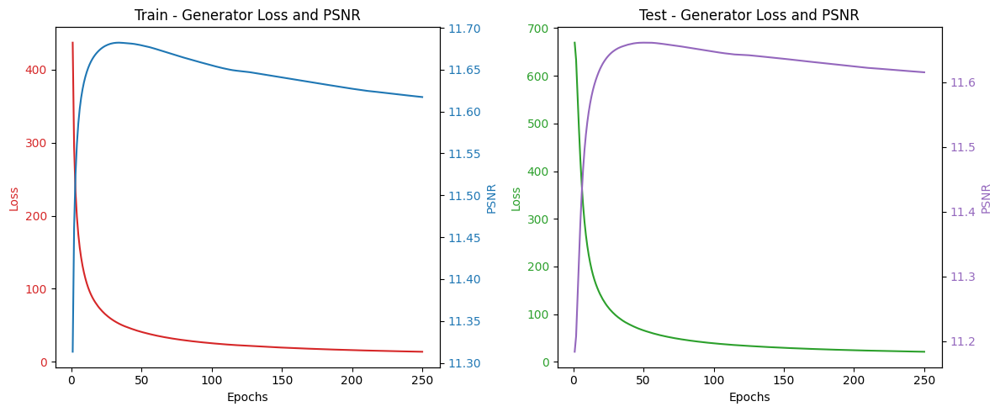

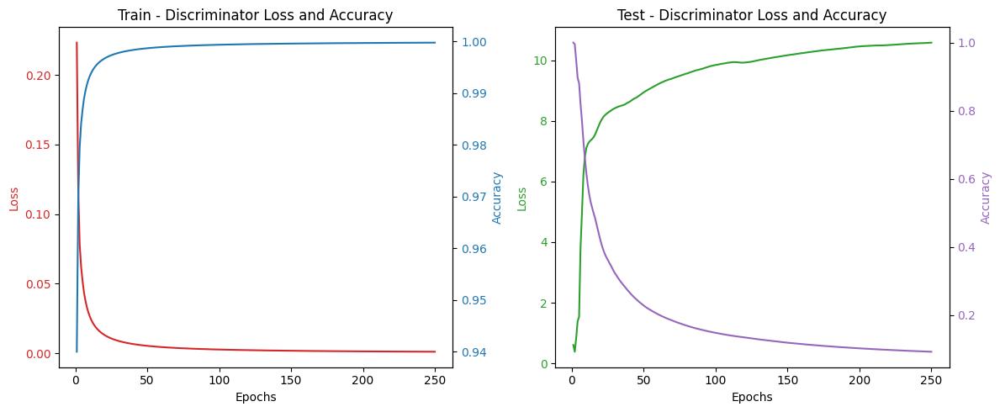

Epoch 251/1000  Train[G_Loss:4.24320 SSIM:13.59% PSNR:11.57 Disc:0.00000 100.000%]  Test[G_Loss:8.76589 SSIM:13.57% PSNR:11.57 Disc:10.97317 5.238%] - 8s  
Epoch 252/1000  Train[G_Loss:4.30180 SSIM:13.60% PSNR:11.57 Disc:0.00000 100.000%]  Test[G_Loss:7.87616 SSIM:13.57% PSNR:11.57 Disc:11.03073 5.238%] - 9s  
Epoch 253/1000  Train[G_Loss:4.35899 SSIM:13.57% PSNR:11.57 Disc:0.00000 100.000%]  Test[G_Loss:8.34873 SSIM:13.55% PSNR:11.57 Disc:11.03842 5.238%] - 9s  
Epoch 254/1000  Train[G_Loss:4.40405 SSIM:13.57% PSNR:11.57 Disc:0.00000 100.000%]  Test[G_Loss:8.58478 SSIM:13.60% PSNR:11.57 Disc:10.91044 5.238%] - 9s  
Epoch 255/1000  Train[G_Loss:4.37653 SSIM:13.57% PSNR:11.57 Disc:0.00000 100.000%]  Test[G_Loss:8.45245 SSIM:13.56% PSNR:11.57 Disc:10.94703 5.238%] - 9s  
Epoch 256/1000  Train[G_Loss:4.32703 SSIM:13.55% PSNR:11.57 Disc:0.00000 100.000%]  Test[G_Loss:7.97184 SSIM:13.55% PSNR:11.57 Disc:11.05925 5.238%] - 9s  
Epoch 257/1000  Train[G_Loss:4.22068 SSIM:13.53% PSNR:11.57 Disc

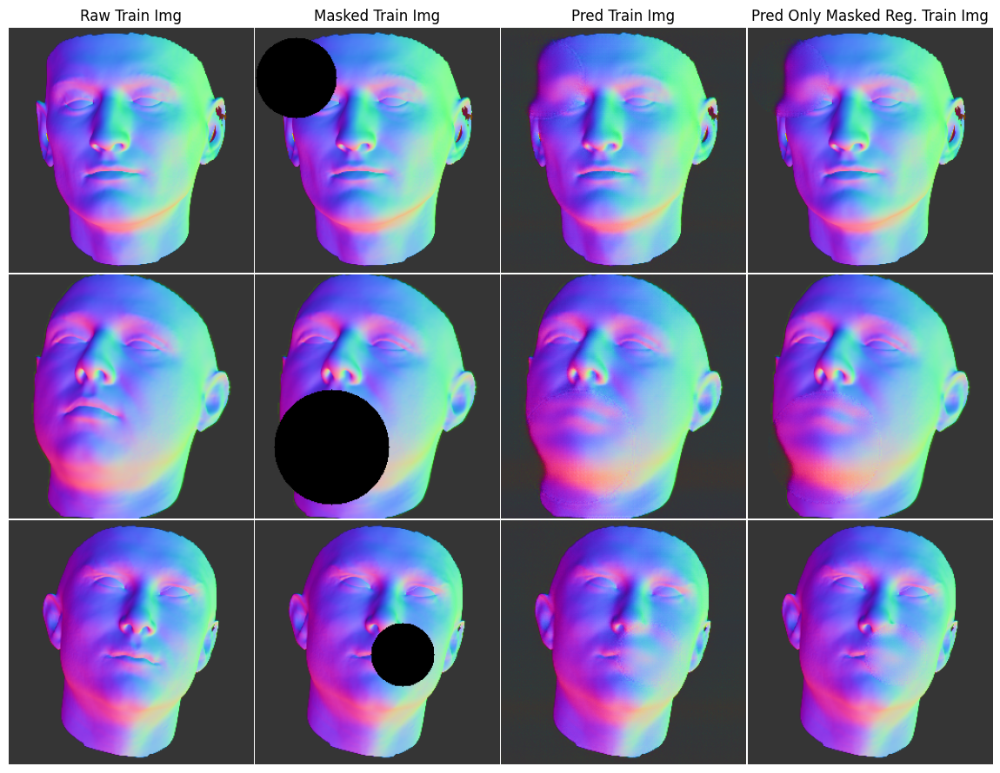

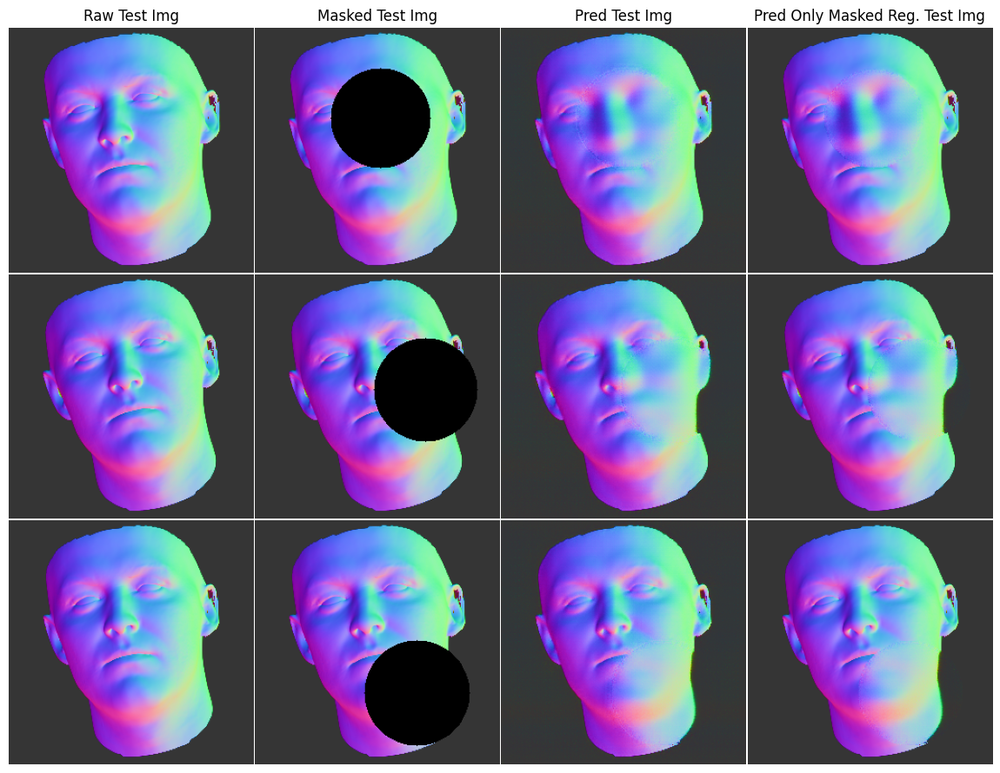

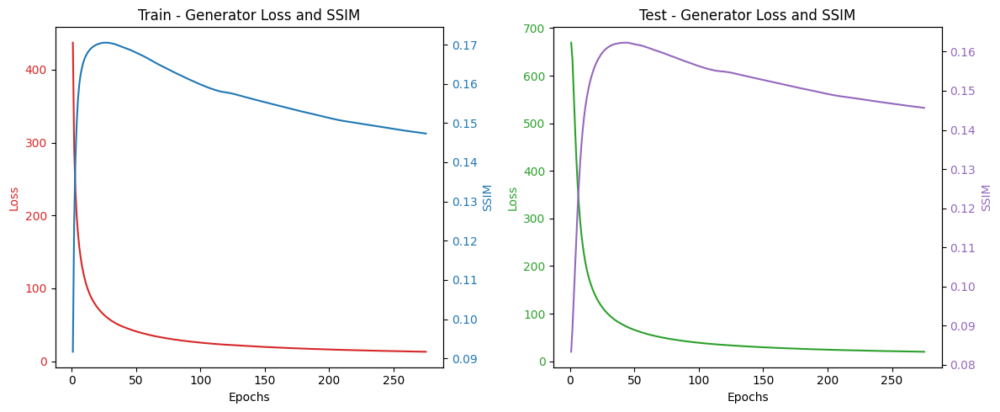

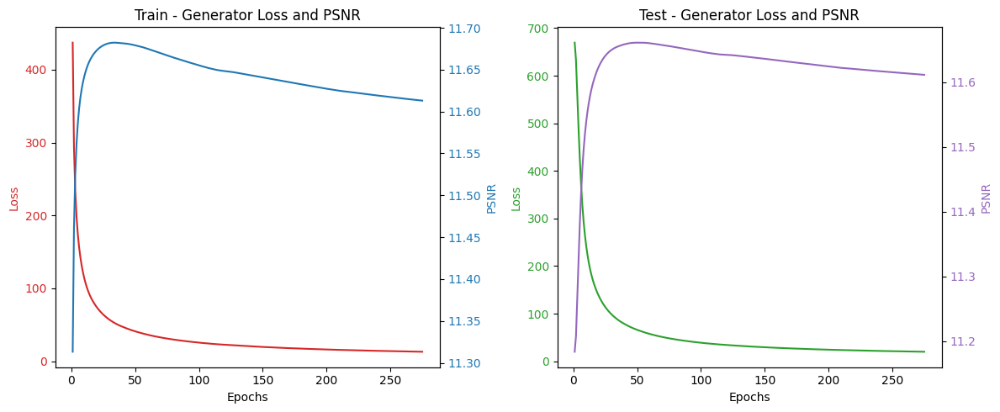

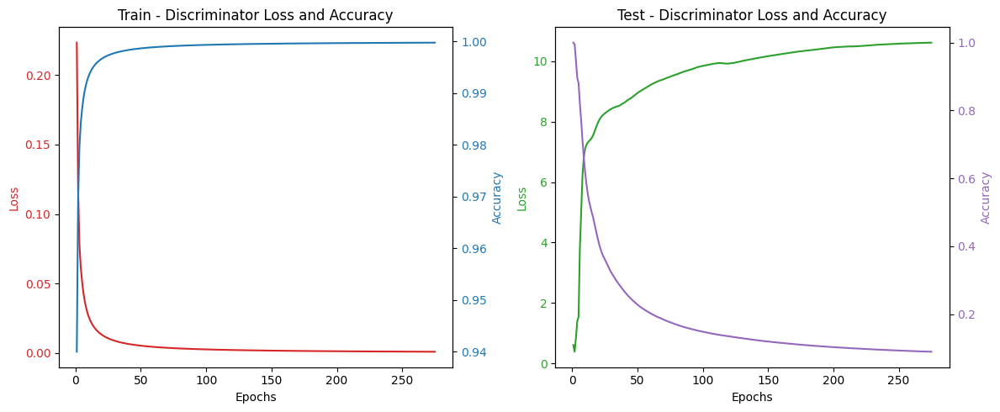

Epoch 276/1000  Train[G_Loss:3.98610 SSIM:13.44% PSNR:11.57 Disc:0.00000 100.000%]  Test[G_Loss:9.05912 SSIM:13.37% PSNR:11.57 Disc:11.07451 5.714%] - 9s  
Epoch 277/1000  Train[G_Loss:4.01792 SSIM:13.44% PSNR:11.57 Disc:0.00000 100.000%]  Test[G_Loss:8.70583 SSIM:13.36% PSNR:11.57 Disc:11.12284 5.714%] - 9s  
Epoch 278/1000  Train[G_Loss:4.02092 SSIM:13.44% PSNR:11.57 Disc:0.00000 100.000%]  Test[G_Loss:8.30268 SSIM:13.37% PSNR:11.57 Disc:11.12994 5.714%] - 9s  
Epoch 279/1000  Train[G_Loss:3.84970 SSIM:13.44% PSNR:11.57 Disc:0.00000 100.000%]  Test[G_Loss:8.78350 SSIM:13.34% PSNR:11.57 Disc:11.21894 5.714%] - 9s  
Epoch 280/1000  Train[G_Loss:3.87372 SSIM:13.42% PSNR:11.57 Disc:0.00000 100.000%]  Test[G_Loss:8.27841 SSIM:13.32% PSNR:11.57 Disc:11.20712 5.714%] - 9s  
Epoch 281/1000  Train[G_Loss:4.02144 SSIM:13.43% PSNR:11.57 Disc:0.00000 100.000%]  Test[G_Loss:7.76933 SSIM:13.34% PSNR:11.57 Disc:11.17143 5.714%] - 9s  
Epoch 282/1000  Train[G_Loss:4.02613 SSIM:13.45% PSNR:11.57 Disc

In [44]:
train(train_dataset, test_dataset, max_epochs=1000, epoch_break=25, batches_list_num=15, generator=generator, discriminator=discriminator)

# Testing and Evaluation on Test Dataset

### Load trained generator

In [44]:
gen_model_pth = './saved_model/generator_best.h5'
if os.path.exists(gen_model_pth):
    print('Load generator model')
    generator = tf.keras.models.load_model(gen_model_pth, custom_objects={'UnitNormalize': UnitNormalize})
    
dis_model_pth = './saved_model/discriminator_best.h5'
if os.path.exists(dis_model_pth):
    print('Load discriminator model')
    discriminator = tf.keras.models.load_model(dis_model_pth, compile=False)

Load generator model
Load discriminator model


### Generate Irregular Mask (batch size) （generate fixed masking lines for testing）

In [45]:
def mask_irregular(batch_size, mask_width, mask_height):
    mask = np.zeros((batch_size, mask_width, mask_height, 1))
    
    for i in range(batch_size):
        # Create a smaller blob in the center with a smaller radius
        cv2.circle(mask[i], (mask_width // 2, mask_height // 2), min(mask_width, mask_height) // 10, (1,1,1), -1)

    return np.float32(((1 - mask)*2) - 1)  # [-1, 1]

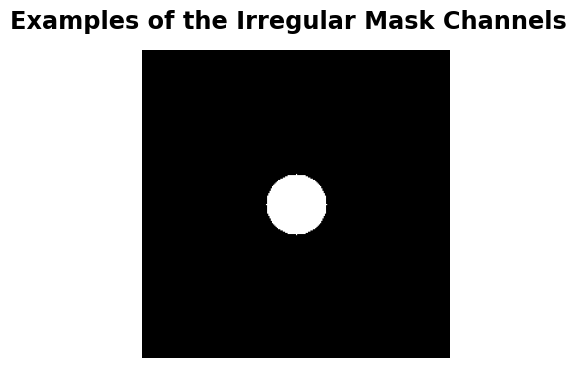

In [46]:
irregular_mask_examples = mask_irregular(6, 256, 256)
for ax, img in zip(ImageGrid(plt.figure(figsize=(6, 4)), 111, nrows_ncols=(1, 1), axes_pad=0.3), 
                   irregular_mask_examples):
    ax.imshow((img+1)/2, cmap='binary')
    ax.axis('off')
plt.suptitle('Examples of the Irregular Mask Channels', fontsize='xx-large',fontweight='heavy')
plt.show()

### Evaluate the function for the dataset

In [47]:
def generator_cosine_similarity_loss(real_images, generated_images):
    # Cosine similarity is maximized, so we negate the value to minimize loss
    return cosine_loss(real_images, generated_images)

In [48]:
# Evaluating data from a single batch
@tf.function
def evaluate_batch(raw_images, mask_channels):
    masked_images = masked_imgs(raw_images, mask_channels)
    generated_images = generator([masked_images, mask_channels], training=False)
    real_output = discriminator(raw_images, training=False)
    fake_output = discriminator(generated_images, training=False)

    return {
        'gen_loss': generator_cosine_similarity_loss(raw_images, generated_images),
        'gen_ssim': generator_ssim(raw_images, generated_images),
        'gen_psnr': generator_psnr(raw_images, generated_images),
        'disc_loss': discriminator_loss(real_output, fake_output),
        'disc_acc': discirminator_acc(real_output, fake_output)
    }

# Overall assessment function
def assessment(dataset):
    metrics_sums = {
        'gen_loss': 0,
        'gen_ssim': 0,
        'gen_psnr': 0,
        'disc_loss': 0,
        'disc_acc': 0
    }
    batch_count = 0
    
    for images_batch in dataset:
        batch_metrics = evaluate_batch(images_batch, mask_irregular(images_batch.shape[0], images_batch.shape[1], images_batch.shape[2]))
        batch_count += 1

        for key in metrics_sums:
            metrics_sums[key] += batch_metrics[key].numpy()

    return {key: total / batch_count for key, total in metrics_sums.items()}

In [49]:
test_metrics = assessment(test_dataset)

print("Test dataset Avg LOSS: {:.4f}\n"
      "Test dataset Avg SSIM: {:.4f}\n"
      "Test dataset Avg PSNR: {:.4f}\n"
      "Test dataset Disc Avg Loss: {:.4f}\n"
      "Test dataset Disc Avg ACC: {:.2f}%".format(test_metrics['gen_loss'], 
                                                  test_metrics['gen_ssim'], 
                                                  test_metrics['gen_psnr'], 
                                                  test_metrics['disc_loss'], 
                                                  test_metrics['disc_acc'] * 100))

Test dataset Avg LOSS: -0.9968
Test dataset Avg SSIM: 0.1337
Test dataset Avg PSNR: 11.5706
Test dataset Disc Avg Loss: 11.1323
Test dataset Disc Avg ACC: 5.71%


In [50]:
print('Pred time for a batch')
for images_batch in test_dataset.take(1):
    test_raw_images = images_batch
    test_mask_channels = mask_irregular(test_raw_images.shape[0], test_raw_images.shape[1], test_raw_images.shape[2])
    test_masked_images = masked_imgs(test_raw_images, test_mask_channels)
    test_pred_images = generator.predict([test_masked_images, test_mask_channels], batch_size=BATCH_SIZE)

Pred time for a batch
1/1 [==============================] - 0s 243ms/step


### Plot Function

In [51]:
def generator_plot_images(gen_model, text, dataset, num=3, save_path='./saved_images', epoch=0, save_images=False, dpi=300):
    os.makedirs(save_path, exist_ok=True)
    
    for images_batch in dataset.take(1):
        raw_images = images_batch
        mask_channels = mask_irregular(raw_images.shape[0], raw_images.shape[1], raw_images.shape[2])
        masked_images = masked_imgs(raw_images, mask_channels)
        pred_images = gen_model([masked_images, mask_channels], training=False)
        pred_images, pred_norm = tf.linalg.normalize(pred_images, axis=3)

        masked_region_pred_images = only_masked_region_pred_imgs(mask_channels, masked_images, pred_images)
    
    grid = ImageGrid(plt.figure(figsize=(12, num*3), dpi=dpi), 111, nrows_ncols=(num, 4))
    
    for i in range(num):
        
        ax = grid[i*4]
        ax.imshow((raw_images[i]+1)/2)
        ax.axis('off')
        if i == 0:
            ax.set_title('Raw {} Img'.format(text))

        ax = grid[i*4+1]
        ax.imshow((masked_images[i]+1)/2)
        ax.axis('off')
        if i == 0:
            ax.set_title('Masked {} Img'.format(text))
            
        ax = grid[i*4+2]
        ax.imshow((pred_images[i]+1)/2)
        ax.axis('off')
        if i == 0:
            ax.set_title('Pred {} Img'.format(text))
        
        ax = grid[i*4+3]
        ax.imshow((masked_region_pred_images[i]+1)/2)
        ax.axis('off')
        if i == 0:
            ax.set_title('Pred Only Masked Reg. {} Img'.format(text))
        
    plt.tight_layout()
    if save_images:
        image_save_path = os.path.join(save_path, f'{text}_epoch_{epoch}.png')
        plt.savefig(image_save_path, dpi=dpi)  # 在保存时指定 DPI   
    plt.show()

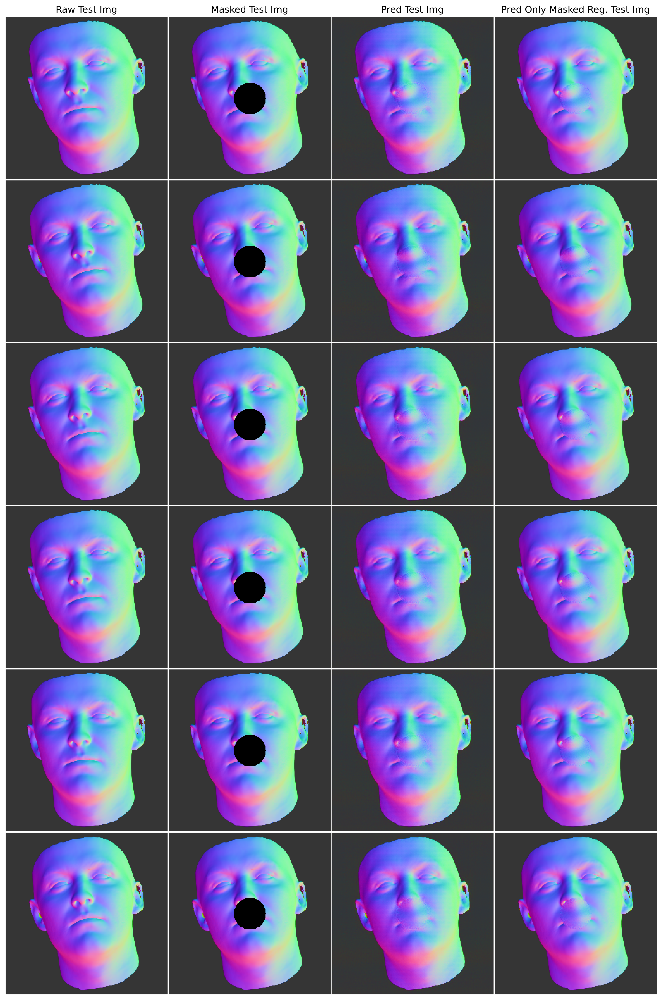

In [52]:
generator_plot_images(generator, 'Test', test_dataset, num = 6, epoch='final', save_images=True)

### Reading and plotting data from log data file

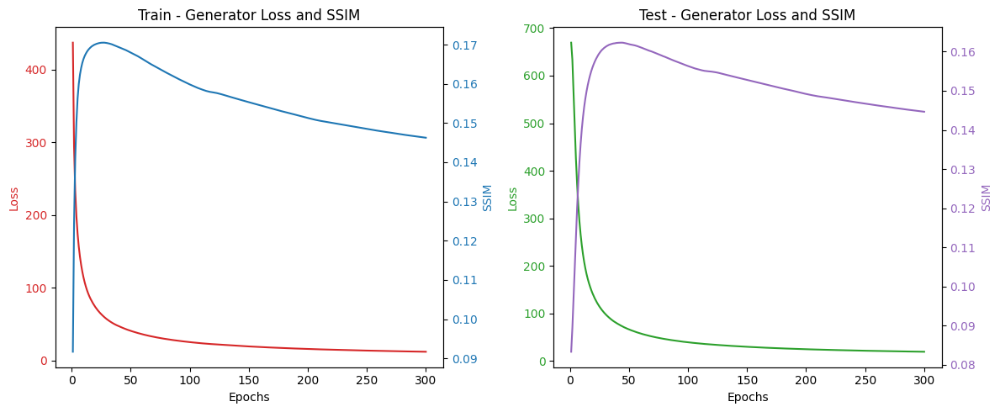

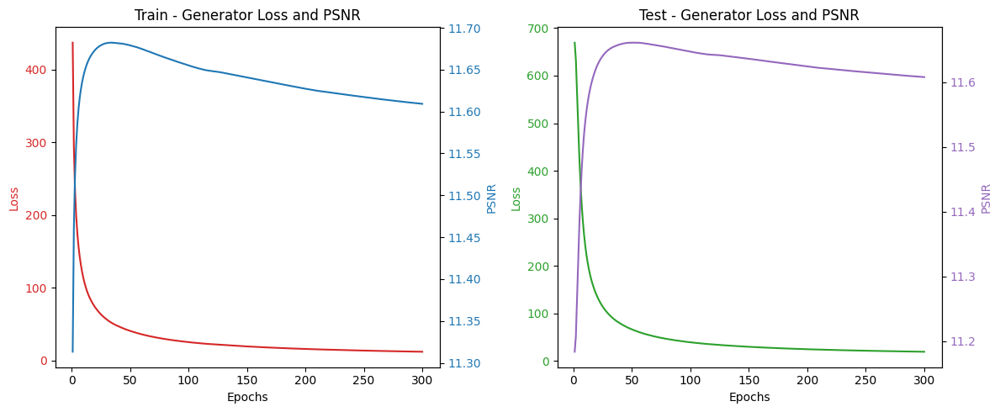

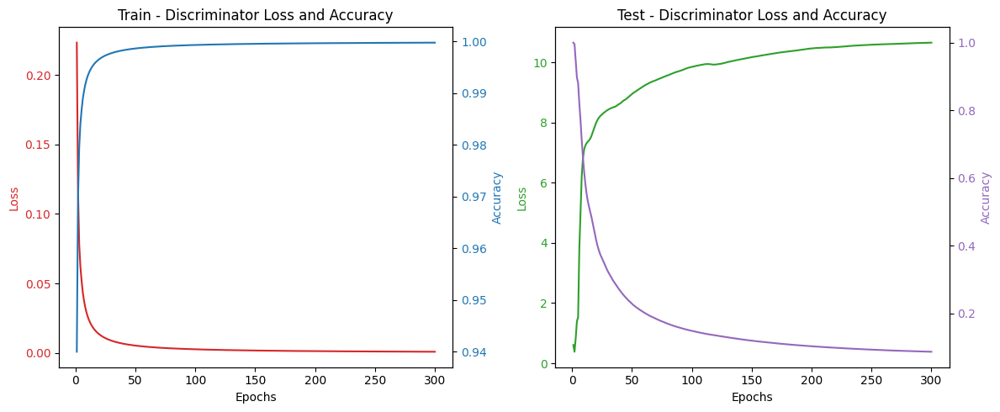

In [53]:
log_dir = './saved_logs'
os.makedirs(log_dir, exist_ok=True)
log_file = os.path.join(log_dir, "GAN_training_results.csv")
plot_metrics(load_metrics_from_csv(log_file))